In [1]:
import json
import os
import argparse

import numpy as np
import random
import torch
from torch import nn, optim
from tqdm.auto import tqdm
from transformers import AutoImageProcessor, AutoModelForImageClassification, AutoConfig
from transformers import AutoTokenizer, AutoModelForSequenceClassification

from torch.utils.data import DataLoader, Subset
import sys
sys.path.append('../../lib/exlib/src')
# from exlib.modules.sop import SOPImageCls, SOPConfig, get_chained_attr
from exlib.datasets.cosmogrid import CosmogridDataset #, CNNModel

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# device = torch.device('cpu')

def seed_all(SEED):
    if SEED != -1:
        # Torch RNG
        torch.manual_seed(SEED)
        torch.cuda.manual_seed(SEED)
        torch.cuda.manual_seed_all(SEED)
        # Python RNG
        np.random.seed(SEED)
        random.seed(SEED)
seed_all(42)

In [3]:
class ModelOutput:
    def __init__(self, logits, pooler_output, hidden_states):
        self.logits = logits
        self.pooler_output = pooler_output
        self.hidden_states = hidden_states
        
class CNNModel(nn.Module):
    def __init__(self, output_num):
        super(CNNModel, self).__init__()
        
        # self.normalization = nn.BatchNorm2d(1)
        self.conv1 = nn.Conv2d(1, 16, kernel_size=4)
        self.relu1 = nn.LeakyReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=2)
        self.conv2 = nn.Conv2d(16, 32, kernel_size=4)
        self.relu2 = nn.LeakyReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=2)
        self.conv3 = nn.Conv2d(32, 48, kernel_size=4)
        self.relu3 = nn.LeakyReLU()
        self.maxpool3 = nn.MaxPool2d(kernel_size=2)
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(1200, 128)
        self.relu4 = nn.LeakyReLU()
        self.fc2 = nn.Linear(128, 64)
        self.relu5 = nn.LeakyReLU()
        self.fc3 = nn.Linear(64, 32)
        self.relu6 = nn.LeakyReLU()
        self.fc4 = nn.Linear(32, output_num)
        
    def forward(self, x, output_hidden_states=False):
        # x = self.normalization(x)
        hidden_states = []
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.maxpool1(x)
        hidden_states.append(x)
        x = self.conv2(x)
        x = self.relu2(x)
        x = self.maxpool2(x)
        hidden_states.append(x)
        x = self.conv3(x)
        x = self.relu3(x)
        x = self.maxpool3(x)
        hidden_states.append(x)
        x = self.flatten(x)
        x = self.fc1(x)
        x = self.relu4(x)
        x = self.fc2(x)
        x = self.relu5(x)
        x = self.fc3(x)
        pooler_output = self.relu6(x)
        logits = self.fc4(pooler_output)
        # for i, hs in enumerate(hidden_states):
        #     print(hs.shape)
        if output_hidden_states:
            return ModelOutput(logits=logits,
                               pooler_output=pooler_output,
                               hidden_states=hidden_states)
        else:
            return ModelOutput(logits=logits,
                               pooler_output=pooler_output,
                               hidden_states=None)

In [4]:
# model paths
# backbone_model_name = 'google/vit-base-patch16-224'
backbone_model_name = '/scratch/datasets/cosmogrid/CNN_mass_maps.pth'
# backbone_model_name = '../pt_models/vit-base-patch16-224-imagenet10cls'
# backbone_processor_name = 'google/vit-base-patch16-224'
# sop_config_path = 'configs/imagenet_m.json'

# data paths
# TRAIN_DATA_DIR = '../data/imagenet/train'
# VAL_DATA_DIR = '../data/imagenet/val'
# TRAIN_DATA_DIR = '/scratch/datasets/imagenet/train'
# VAL_DATA_DIR = '/scratch/datasets/imagenet/val'
TRAIN_DATA_DIR = '/scratch/datasets/cosmogrid'
VAL_DATA_DIR = '/scratch/datasets/cosmogrid'
mask_path = '../../data/processed/cosmogrid/masks/X_maps_Cosmogrid_100k_watershed_diagonal.npy'

# TRAIN_SEG_DIR = '/shared_data0/weiqiuy/github/ImageNet-S/datapreparation/ImageNetS919/train-semi-segmentation'
# VAL_SEG_DIR = '/shared_data0/weiqiuy/github/ImageNet-S/datapreparation/ImageNetS919/validation-segmentation'

# training args
batch_size = 16
lr = 0.000005
num_epochs = 20
warmup_steps = 2000
mask_batch_size = 64
num_heads = 4

mask_big_first = True
even_data_sample = True

backbone_layer = -2
bbl_ihs_mapping = {
    -1: 48,
    -2: 32,
    -3: 16
}
input_hidden_size = bbl_ihs_mapping[backbone_layer]
# seg = None
seg = 'patch'
# seg = 'seg'

# experiment args
# exp_dir = '../exps/debug_lr5e-06_tgtnnz0.3_gg0.0002_change/best'
# exp_dir_load = '../exps/debug_lr5e-06_tgtnnz0.3_gg0.0002_change/best'
# exp_dir_load = '../exps/imagenet_lr1e-06_tgtnnz0.2_tgtnm4_gg0.0002_gs0.5_ft_gen_sc_bin/best'
exp_dir_load = '../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best'
# exp_dir = '../exps/debug_lr5e-06_tgtnnz0.3/best'
# exp_dir = '../exps/imagenet_bbmvit_1h_lr8e-06_gg0.05_gs1.0_ggta1.0_ggtb0.1_ts-1_vs1_stcosine_ep0.5_ft_ggbk115_ggbs115_ggbk2-1_ggbs2-1_pjembed/best'
# exp_dir = '../exps/imagenet_bbmvit_1h_lr8e-06_gg0.05_gs1.0_ggta1.0_ggtb0.1_ts-1_vs1_stcosine_ep0.5_ft_ggbk115_ggbs115_ggbk2-1_ggbs2-1/best'

In [5]:
from exlib.modules.sop import SOPConfig, get_chained_attr

# backbone_model = AutoModelForImageClassification.from_pretrained(backbone_model_name)
# processor = AutoImageProcessor.from_pretrained(backbone_processor_name)
# backbone_config = AutoConfig.from_pretrained(backbone_model_name)

# config = SOPConfig(os.path.join(exp_dir_load, 'config.json'))
# config.__dict__
config = SOPConfig(
    hidden_size=32,
    num_labels=2,
    input_hidden_size=input_hidden_size,
    attn_patch_size=6,
    num_heads=num_heads,
    num_masks_sample=20,
    num_masks_max=200,
    image_size=66,
    num_channels=1,
    finetune_layers=['fc4'],
    group_gen_scale=0.06,#0.00027,
    group_sel_scale=10,
    group_gen_temp_alpha=1,
    group_gen_temp_beta=1,
    group_gen_blur_ks1=1,
    group_gen_blur_sigma1=1,
    group_gen_blur_ks2=-1,
    group_gen_blur_sigma2=-1,
    projected_input_scale=1
)

backbone_model = CNNModel(config.num_labels)
state_dict = torch.load(backbone_model_name)
backbone_model.load_state_dict(state_dict=state_dict)
processor = None

# config.__dict__.update(backbone_config.__dict__)
# config.num_labels = len(backbone_config.id2label)

In [6]:
from torch.utils.data import Dataset
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn.functional as F

def resize_binary_image(image, size, mode='bilinear'):
    # Resize the image
    resized_image = F.interpolate(image, size=size, mode=mode, align_corners=False)

    # Threshold the image to convert values back to binary (0 or 1)
    thresholded_image = (resized_image > 0.5).float()

    return thresholded_image


In [7]:

import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader


# Load the dataset
train_size, val_size = -1, 1000
# train_size, val_size = args.train_size, args.val_size #-1, 1000
# train_size, val_size = 100, 100

train_dataset = CosmogridDataset(data_dir=TRAIN_DATA_DIR, split='train', data_size=train_size,
                                 inputs_filename='X_maps_Cosmogrid_100k.npy',
                                 labels_filename='y_maps_Cosmogrid_100k.npy',
                                 mask_path=mask_path,
                                num_masks_max=config.num_masks_max,
                                mask_big_first=mask_big_first,
                                even_data_sample=even_data_sample)
val_dataset = CosmogridDataset(data_dir=TRAIN_DATA_DIR, split='val', data_size=val_size,
                               inputs_filename='X_maps_Cosmogrid_100k.npy',
                                 labels_filename='y_maps_Cosmogrid_100k.npy',
                                 mask_path=mask_path,
                                num_masks_max=config.num_masks_max,
                                mask_big_first=mask_big_first,
                                even_data_sample=even_data_sample)

train_val_dataset = CosmogridDataset(data_dir=TRAIN_DATA_DIR, split='train', data_size=val_size,
                                 inputs_filename='X_maps_Cosmogrid_100k.npy',
                                 labels_filename='y_maps_Cosmogrid_100k.npy',
                                 mask_path=mask_path,
                                num_masks_max=config.num_masks_max,
                                mask_big_first=mask_big_first,
                                even_data_sample=even_data_sample)
test_dataset = CosmogridDataset(data_dir=TRAIN_DATA_DIR, split='test', data_size=val_size,
                               inputs_filename='X_maps_Cosmogrid_100k.npy',
                                 labels_filename='y_maps_Cosmogrid_100k.npy',
                                 mask_path=mask_path,
                                num_masks_max=config.num_masks_max,
                                mask_big_first=mask_big_first,
                                even_data_sample=even_data_sample)

# Use subset for testing purpose
# num_data = 100
# train_dataset = Subset(train_dataset, range(num_data))
# val_dataset = Subset(val_dataset, range(num_data))

# Create a DataLoader to batch and shuffle the data
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
train_val_dataloader = DataLoader(train_val_dataset, batch_size=batch_size, shuffle=False)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# samples used for training: 80000
# samples used for validation: 10000
# samples used for testing: 10000
# total samples: 100000
x shape (80000, 66, 66) (10000, 66, 66) (10000, 66, 66)
y shape (80000, 6) (10000, 6) (10000, 6)
masks shape (80000, 66, 66) (10000, 66, 66) (10000, 66, 66)
-- ALL --
max 0.7257571922558966
min -0.034935039865926346
-- SPLIT train --
max 0.7257571922558966
min -0.034935039865926346
Finished loading 80000 train images ... 
# samples used for training: 80000
# samples used for validation: 10000
# samples used for testing: 10000
# total samples: 100000
x shape (80000, 66, 66) (10000, 66, 66) (10000, 66, 66)
y shape (80000, 6) (10000, 6) (10000, 6)
masks shape (80000, 66, 66) (10000, 66, 66) (10000, 66, 66)
-- ALL --
max 0.6323861033355062
min -0.031224769235240986
-- SPLIT val --
max 0.30906816937089127
min -0.02956989103067589
Finished loading 1000 val images ... 
# samples used for training: 80000
# samples used for validation: 10000
# samples used for testin

In [32]:
import math
import matplotlib.pyplot as plt
import matplotlib
from scipy.ndimage import binary_dilation
from skimage import measure


def map_plotter(image, mask, ax=plt, type='dim'): 
    default_cmap = matplotlib.rcParams['image.cmap']
    cmap = plt.get_cmap(default_cmap)
    gray_cmap = plt.get_cmap('gray')
    
    norm = plt.Normalize()
    normed_image = norm(image)
    # normed_image = np.clip((image - img_min) / (img_max - img_min) * 3, 0, 1)
    rgb_image = cmap(normed_image)
    if type == 'dim':
        gray_image = (gray_cmap(normed_image) / 2)
        mask_bool = np.repeat((mask > 0)[:,:,None], 4, axis=-1)
        gray_image[mask_bool] = rgb_image[mask_bool]
        ax.imshow(gray_image)
    elif type == 'contour':
        # 1. Find the contours of the mask
        mask_bool = (mask > 0).astype(np.float32)
        dilated_mask_bool = binary_dilation(mask_bool)
        contours_original = measure.find_contours(mask_bool, 0.5)
        contours_dilated = measure.find_contours(dilated_mask_bool, 0.51)

        # 2. Overlay the contours on top of the original image
        # fig, ax = plt.subplots()
        ax.imshow(rgb_image)

        for contour in contours_dilated:
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')  # color can be changed as needed

        for contour in contours_original:
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')  # color can be changed as needed

def show_masked_img(img, mask, ax):
    map_plotter(img[0].cpu().numpy(), 
                    mask.cpu().numpy(),
                   ax)
    # ax.imshow(img.permute(1,2,0).cpu().numpy())
    # ax.imshow(mask.cpu().numpy(), cmap='hot', alpha=0.2)
    # ax.contour(mask.cpu().numpy(), 2, colors='black', linestyles='dashed')
    # ax.contourf(mask.cpu().numpy(), 2, hatches=['//', None, None],
    #             cmap='gray', extend='neither', linestyles='-', alpha=0.01)
    # ax.axis('off')
    
def show_masks(img, masks, titles=None, cols=5, imgsize=3):
    n_masks = len(masks)
    rows = math.ceil(n_masks / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(cols * imgsize, rows * imgsize))
    axes = axes.ravel()
    for m_i in range(len(masks)):
        mask = masks[m_i]
        show_masked_img(img, mask, axes[m_i])
        if titles is not None:
            axes[m_i].set_title(titles[m_i])
    for m_i in range(len(masks), len(axes)):
        axes[m_i].axis('off')
    plt.show()
    
def get_mask_weights_titles(mask_weights):
    titles = [f'{mask_weight.item():.10f}' for mask_weight in mask_weights]
    return titles

In [9]:
wrapped_backbone_model = backbone_model
wrapped_backbone_model = wrapped_backbone_model.to(device)
class_weights = get_chained_attr(wrapped_backbone_model, config.finetune_layers[0]).weight #.clone().to(device)
# projection_layer_emb = backbone_model.vit.embeddings

# projection_layer = lambda x: projection_layer_emb(x)[:,1:].transpose(1,2).reshape(-1, config.hidden_size, patch_size, patch_size)
# projection_layer = None

# class ProjectionLayerWrapper(nn.Module):
#     def __init__(self, model):
#         super().__init__()
#         self.model = model
#         self.num_patch = 14
        
#     def forward(self, x):
#         return self.model.model(x, output_hidden_states=True).hidden_states[-2][:,1:].transpose(1,2).reshape(-1, 
#                             config.hidden_size, self.num_patch, self.num_patch)
    
class ProjectionLayerWrapper(nn.Module):
    def __init__(self, model, layer):
        super().__init__()
        self.model = model
        self.layer = layer        
    
    def forward(self, inputs):
        outputs = self.model(inputs, output_hidden_states=True)
        return outputs.hidden_states[self.layer]
    
projection_layer = ProjectionLayerWrapper(wrapped_backbone_model, layer=backbone_layer)

In [10]:
from exlib.modules.sop import SOPImageCls, default_projection_func, SparseMultiHeadedAttention, same_tensor, Sparsemax, compress_masks_image
import math
import collections
import torch.nn.functional as F
import torchvision
from collections import namedtuple


# def default_projection_func(blackbox_model, inputs):
#     # This is an example projection function. Customize as needed.
#     projected_inputs = blackbox_model.model(inputs, output_hidden_states=True).hidden_states[-2][:,1:].transpose(1,2)
#     num_patch = 14  # Example patch size. Customize as needed.
#     projected_inputs = projected_inputs.reshape(-1, 
#                                                 blackbox_model.model.config.hidden_size, num_patch, num_patch)
#     return projected_inputs

AttributionOutputSOP = namedtuple("AttributionOutputSOP", 
                                  ["logits",
                                   "logits_all",
                                   "pooler_outputs_all",
                                   "masks",
                                   "mask_weights",
                                   "attributions", 
                                   "attributions_max",
                                   "attributions_all",
                                   "flat_masks",
                                   "grouped_attributions",
                                  "loss_scale"])

class SparseMultiHeadedAttentionBlur(nn.Module):
    ''' Implement a multi-headed attention module '''
    def __init__(self, embed_dim, num_heads=1, scale=1, kernel_size=1, sigma=1):
        ''' Initialize the attention module '''
        super().__init__()

        # ensure valid inputs
        assert embed_dim % num_heads == 0, \
            f'num_heads={num_heads} should evenly divide embed_dim={embed_dim}'

        # store off the scale and input params
        self.embed_dim = embed_dim
        self.num_heads = num_heads
        self.projection_dim = embed_dim // num_heads
        self.scale = scale
        self.kernel_size = kernel_size
        self.sigma = sigma
        # self.scale = self.projection_dim ** -0.5

        # Combine projections for multiple heads into a single linear layer for efficiency
        self.input_weights = nn.Parameter(torch.Tensor(3 * embed_dim, embed_dim))
        self.output_projection = nn.Linear(embed_dim, embed_dim, bias=False)
        # self.sparsemax = Sparsemax(dim=-1)
        self.reset_parameters()

    def reset_parameters(self):
        ''' Reset parameters using xavier initialization '''
        # Initialize using Xavier
        gain = nn.init.calculate_gain('linear')
        nn.init.xavier_uniform_(self.input_weights, gain)
        nn.init.xavier_uniform_(self.output_projection.weight, gain)

    def project(self, inputs, index=0, chunks=1):
        ''' Produce a linear projection using the weights '''
        batch_size = inputs.shape[0]
        start = index * self.embed_dim
        end = start + chunks * self.embed_dim
        # import pdb; pdb.set_trace()
        projections = F.linear(inputs, self.input_weights[start:end]).chunk(chunks, dim=-1)

        output_projections = []
        for projection in projections:
            # transform projection to (BH x T x E)
            output_projections.append(
                projection.view(
                    batch_size,
                    -1,
                    self.num_heads,
                    self.projection_dim
                ).transpose(2, 1).contiguous().view(
                    batch_size * self.num_heads,
                    -1,
                    self.projection_dim
                )
            )

        return output_projections

    def attention(self, queries, keys, values):
        ''' Scaled dot product attention with optional masks '''
        logits = self.scale * torch.bmm(queries, keys.transpose(2, 1))

        if self.kernel_size != 1 and self.sigma != 1:
            num_patches = int(math.sqrt(logits.shape[-1]))
            bsz, num_groups, _ = logits.shape
            logits_reshape = logits.view(bsz, num_groups, num_patches, num_patches)
            logits_reshape_blurred = torchvision.transforms.functional.gaussian_blur(logits_reshape, self.kernel_size, self.sigma)
            logits = logits_reshape_blurred.flatten(-2)
        
        attn_weights = F.softmax(logits, dim=-1)
        return attn_weights

    def forward(self, queries, keys, values):
        ''' Forward pass of the attention '''
        # pylint:disable=unbalanced-tuple-unpacking
        if same_tensor(values, keys, queries):
            values, keys, queries = self.project(values, chunks=3)
        elif same_tensor(values, keys):
            values, keys = self.project(values, chunks=2)
            queries, = self.project(queries, 2)
        else:
            values, = self.project(values, 0)
            keys, = self.project(keys, 1)
            queries, = self.project(queries, 2)

        attn_weights = self.attention(queries, keys, values)
        return attn_weights


class GroupGenerateLayerBlur(nn.Module):
    def __init__(self, hidden_dim, num_heads, scale=1, kernel_size=1, sigma=1):
        super().__init__()
        
        self.hidden_dim = hidden_dim
        self.num_heads = num_heads
        self.scale = scale
        self.kernel_size = kernel_size
        self.sigma = sigma
       
        self.multihead_attns = nn.ModuleList([SparseMultiHeadedAttentionBlur(hidden_dim, 
                                                                             scale=scale,
                                                                             kernel_size=kernel_size,
                                                                             sigma=sigma) \
                                                for _ in range(num_heads)])

    def forward(self, query, key_value, epoch=0):
        """
            Use multiheaded attention to get mask
            Num_interpretable_heads = num_heads * seq_len
            Input: x (bsz, seq_len, hidden_dim)
                   if actual_x is not None, then use actual_x instead of x to compute attn_output
            Output: attn_outputs (bsz, num_heads * seq_len, seq_len, hidden_dim)
                    mask (bsz, num_heads, seq_len, seq_len)
        """

        if epoch == -1:
            epoch = self.num_heads
        
        head_i = epoch % self.num_heads
        if self.training:
            attn_weights = self.multihead_attns[head_i](query, key_value, key_value)
        else:
            attn_weights = []
            if epoch < self.num_heads:
                num_heads_use = head_i + 1
            else:
                num_heads_use = self.num_heads
            for head_j in range(num_heads_use):
                attn_weights_j = self.multihead_attns[head_j](query, key_value, key_value)
                attn_weights.append(attn_weights_j)
            attn_weights = torch.stack(attn_weights, dim=1)
        # import pdb; pdb.set_trace()
        # attn_weights = 
        return attn_weights

class GroupSelectLayerPower(nn.Module):
    def __init__(self, hidden_dim, scale=1, proj=None):
        super().__init__()
        
        self.hidden_dim = hidden_dim
        self.proj = copy.deepcopy(proj)
        self.multihead_attn = SparseMultiHeadedAttention(hidden_dim, scale=scale)
        self.scale = scale
        
        embed_dim = self.multihead_attn.embed_dim
        identity_matrix = torch.eye(embed_dim)
        self.multihead_attn.input_weights.data = identity_matrix[None].expand(3, embed_dim, embed_dim).reshape(-1, embed_dim)

    def forward(self, query, key, value):
        """
            Use multiheaded attention to get mask
            Num_heads = num_heads * seq_len
            Input: x (bsz, seq_len, hidden_dim)
                   if actual_x is not None, then use actual_x instead of x to compute attn_output
            Output: attn_outputs (bsz, num_heads * seq_len, seq_len, hidden_dim)
                    mask (bsz, num_heads, seq_len, seq_len)
        """
        # x shape: (batch_size, sequence_length, hidden_dim)
        # x shape: (..., hidden_dim)
        if self.proj is not None:
            # query = self.proj(query) # query is the class weights, which doesn't need to use the last layer to encode. maybe it can be encoded with other ways
            # print('key a', key.shape)
            key = self.proj(key)[0]
            # print('key b', key.shape)
            
        epsilon = 1e-30
        # import pdb; pdb.set_trace()
        bsz, seq_len, hidden_dim = query.shape

        # Obtain attention weights
        attn_weights = self.multihead_attn(query, key, key)
        mask = attn_weights.transpose(-1, -2)

        # Apply attention weights on what to be attended
        new_shape = list(mask.shape) + [1] * (len(value.shape) - 3)
        attn_outputs = (value * mask.view(*new_shape)).sum(1)

        # attn_outputs of shape (bsz, num_masks, num_classes)
        return attn_outputs, mask
    
    
class SOPImageCls4(SOPImageCls):
    
    def __init__(self, 
                 config,
                 blackbox_model,
                 class_weights=None,
                 projection_layer=None,
                 k=0.2,
                 group_selector_proj=None
                 ):
        super().__init__(config,
                            blackbox_model,
                            class_weights,
                            projection_layer
                            )
        self.group_gen_blur_ks1 = config.group_gen_blur_ks1
        self.group_gen_blur_sigma1 = config.group_gen_blur_sigma1
        
        self.input_attn = GroupGenerateLayerBlur(hidden_dim=self.input_hidden_size,
                                             num_heads=self.num_heads,
                                             scale=self.group_gen_scale,
                                             kernel_size=config.group_gen_blur_ks1,
                                             sigma=config.group_gen_blur_sigma1
                                                )
        self.output_attn = GroupSelectLayerPower(hidden_dim=self.hidden_size,
                                            scale=self.group_sel_scale,
                                            proj=group_selector_proj)
        
        self.image_size = config.image_size if isinstance(config.image_size, 
                                                    collections.abc.Iterable) \
                                            else (config.image_size, config.image_size)
        self.num_channels = config.num_channels
        # attention args
        self.attn_patch_size = config.attn_patch_size
        
        self.init_grads()
        
        for name, param in self.projection.named_parameters():
            param.requires_grad = True
            
        self.k = k
        
    def forward(self, 
                inputs, 
                segs=None, 
                input_mask_weights=None,
                epoch=-1, 
                mask_batch_size=16,
                label=None,
                return_tuple=False,
                binary_threshold=-1):
        if epoch == -1:
            epoch = self.num_heads
        bsz, num_channel, img_dim1, img_dim2 = inputs.shape
        c = None
        
        # Mask (Group) generation
        if input_mask_weights is None:
            grouped_inputs, input_mask_weights, c = self.group_generate(inputs, epoch, mask_batch_size, segs, binary_threshold)
        else:
            grouped_inputs = inputs.unsqueeze(1) * input_mask_weights.unsqueeze(2) # directly apply mask

        # Backbone model
        logits, pooler_outputs = self.run_backbone(grouped_inputs, mask_batch_size)
        # print('logits', logits.shape, 'c', c.shape)
        # if c is not None and not test:
        #     logits = logits * c[:,:,None,None] / c.sum(1)[:,None,None,None]
        # return logits

        # Mask (Group) selection & aggregation
        weighted_logits, output_mask_weights, logits, pooler_outputs = self.group_select(logits, pooler_outputs, img_dim1, img_dim2)
        
        if return_tuple:
            return self.get_results_tuple(weighted_logits, 
                                          logits, 
                                          pooler_outputs, 
                                          input_mask_weights, 
                                          output_mask_weights, 
                                          bsz, 
                                          label, 
                                          c)
        else:
            return weighted_logits
        
    def get_results_tuple(self, weighted_logits, logits, pooler_outputs, input_mask_weights, 
                          output_mask_weights, bsz, label, c):
        # todo: debug for segmentation
        masks_aggr = None
        masks_aggr_pred_cls = None
        masks_max_pred_cls = None
        flat_masks = None

        if label is not None:
            predicted = label  # allow labels to be different
        else:
            _, predicted = torch.max(weighted_logits.data, -1)
        
        grouped_attributions = output_mask_weights * logits # instead of just output_mask_weights
        # import pdb; pdb.set_trace()
        masks_mult_pred = input_mask_weights * grouped_attributions[range(len(predicted)),:,predicted,None,None]
        masks_aggr_pred_cls = masks_mult_pred.sum(1)[:,None,:,:]
        max_mask_indices = grouped_attributions.max(2).values.max(1).indices
        # import pdb; pdb.set_trace()
        masks_max_pred_cls = masks_mult_pred[range(bsz),max_mask_indices]

        flat_masks = compress_masks_image(input_mask_weights, grouped_attributions[:,:,predicted])
        
        return AttributionOutputSOP(weighted_logits,
                                    logits,
                                    pooler_outputs,
                                    input_mask_weights,
                                    output_mask_weights,
                                    masks_aggr_pred_cls,
                                    masks_max_pred_cls,
                                    masks_aggr,
                                    flat_masks,
                                    grouped_attributions,
                                    c)
    
    def group_generate(self, inputs, epoch, mask_batch_size, segs=None, binary_threshold=-1):
        bsz, num_channel, img_dim1, img_dim2 = inputs.shape
        c = None
        if segs is None:   # should be renamed "segments"
            projected_inputs = self.projection(inputs)
            
            num_patches = projected_inputs.shape[-2:]
            projected_inputs = projected_inputs.flatten(2).transpose(1, 2)  # bsz, img_dim1 * img_dim2, num_channel
            projected_inputs = projected_inputs * self.projected_input_scale

            if self.num_masks_max != -1:
                projected_query = projected_inputs[:, :self.num_masks_max]
            else:
                projected_query = projected_inputs
            input_mask_weights_cand = self.input_attn(projected_query, projected_inputs, epoch=epoch)
            
            input_mask_weights_cand = input_mask_weights_cand.reshape(-1, num_patches[0]*num_patches[1])
            input_mask_weights_sort = input_mask_weights_cand.sort(-1)
            input_mask_weights_sort_values = input_mask_weights_sort.values.flip(-1)
            input_mask_weights_sort_indices = input_mask_weights_sort.indices.flip(-1)

            # get k scale
            topk = int(input_mask_weights_sort_values.shape[-1] * self.k)
            pos = input_mask_weights_sort_values[:,:topk]
            neg = input_mask_weights_sort_values[:,topk:]
            c = pos.sum(-1) - neg.sum(-1)
            c = c.view(bsz, -1)
            masks_all = torch.zeros_like(input_mask_weights_cand)
            masks_all[torch.arange(masks_all.size(0)).unsqueeze(1), input_mask_weights_sort_indices[:, :topk]] = 1
            masks_all = masks_all.view(bsz, -1, *num_patches)
            masks_all = torch.nn.functional.interpolate(masks_all, size=(img_dim1, img_dim2), mode='nearest')
            input_mask_weights_cand = masks_all
        else:
            # With/without masks are a bit different. Should we make them the same? Need to experiment.
            bsz, num_segs, img_dim1, img_dim2 = segs.shape
            seged_output_0 = inputs.unsqueeze(1) * segs.unsqueeze(2) # (bsz, num_masks, num_channel, img_dim1, img_dim2)
            # import pdb; pdb.set_trace()
            _, interm_outputs = self.run_backbone(seged_output_0, mask_batch_size)
            
            interm_outputs = interm_outputs.view(bsz, -1, self.hidden_size)
            interm_outputs = interm_outputs * self.projected_input_scale
            segment_mask_weights = self.input_attn(interm_outputs, interm_outputs, epoch=epoch)
            segment_mask_weights = segment_mask_weights.reshape(bsz, -1, num_segs)
            
            new_masks =  segs.unsqueeze(1) * segment_mask_weights.unsqueeze(-1).unsqueeze(-1)
            # (bsz, num_new_masks, num_masks, img_dim1, img_dim2)
            input_mask_weights_cand = new_masks.sum(2)  # if one mask has it, then have it
            # todo: Can we simplify the above to be dot product?
            
            
        scale_factor = 1.0 / input_mask_weights_cand.reshape(bsz, -1, 
                                                        img_dim1 * img_dim2).max(dim=-1).values
        input_mask_weights_cand = input_mask_weights_cand * scale_factor.view(bsz, -1,1,1)
        
        # dropout
        dropout_mask = torch.zeros(bsz, input_mask_weights_cand.shape[1]).to(inputs.device)
        keep_group_idxs = torch.arange(self.num_masks_sample) * input_mask_weights_cand.shape[1] // self.num_masks_sample

        dropout_mask[:, keep_group_idxs] = 1
        if c is not None:
            c = c[dropout_mask.bool()].view(bsz, -1)
        
        input_mask_weights = input_mask_weights_cand[dropout_mask.bool()].clone()
        input_mask_weights = input_mask_weights.view(bsz, -1, img_dim1, img_dim2)

        masked_inputs = inputs.unsqueeze(1) * input_mask_weights.unsqueeze(2)
        return masked_inputs, input_mask_weights, c

In [11]:
import copy
# group_selector_proj = copy.deepcopy(wrapped_backbone_model.model.vit.encoder.layer[-1])
group_selector_proj = None
# config.group_sel_scale = 0.01

In [12]:
seed_all(42)
model = SOPImageCls4(config, wrapped_backbone_model, 
                     class_weights=class_weights, projection_layer=projection_layer,
                    group_selector_proj=group_selector_proj)
state_dict = torch.load(os.path.join(exp_dir_load, 'checkpoint.pth'))
print('Loaded step', state_dict['step'])
model.load_state_dict(state_dict['model'], strict=False)
model = model.to(device)
model.eval();

projection layer is not frozen
projection layer is not frozen
Loaded step 17101


In [13]:
# # set groupsel matrix to identity matrices
# embed_dim = model.output_attn.multihead_attn.embed_dim
# identity_matrix = torch.eye(embed_dim).to(model.output_attn.multihead_attn.input_weights.device)
# model.output_attn.multihead_attn.input_weights.data = identity_matrix[None].expand(3, 
#                                                                                    embed_dim, 
#                                                                                    embed_dim).reshape(-1, embed_dim)

In [14]:
for name, param in model.named_parameters():
    if 'blackbox_model' in name:
        param.requires_grad = False
    # if 'input_attn' in name:
    #     param.requires_grad = True
    # if 'output_attn' in name:
    #     param.requires_grad = True
    if 'projection.model' in name:
        param.requires_grad = False
        
# Check which parameters are frozen and which require gradients
for name, param in model.named_parameters():
    if param.requires_grad:
        print(f'Parameter: {name} - Requires gradients')
    # else:
    #     print(f'Parameter: {name} - Frozen')


Parameter: class_weights - Requires gradients
Parameter: input_attn.multihead_attns.0.input_weights - Requires gradients
Parameter: input_attn.multihead_attns.0.output_projection.weight - Requires gradients
Parameter: input_attn.multihead_attns.1.input_weights - Requires gradients
Parameter: input_attn.multihead_attns.1.output_projection.weight - Requires gradients
Parameter: input_attn.multihead_attns.2.input_weights - Requires gradients
Parameter: input_attn.multihead_attns.2.output_projection.weight - Requires gradients
Parameter: input_attn.multihead_attns.3.input_weights - Requires gradients
Parameter: input_attn.multihead_attns.3.output_projection.weight - Requires gradients
Parameter: output_attn.multihead_attn.input_weights - Requires gradients
Parameter: output_attn.multihead_attn.output_projection.weight - Requires gradients


In [15]:
def get_masks_used(outputs, i=0, pred=0):
    # pred = outputs.logits[i].argmax(-1).item()
    pred_mask_idxs_sort = outputs.mask_weights[i,:,pred].argsort(descending=True)
    # mask_weights_sort = (outputs.mask_weights * outputs.logits_all)[i,pred_mask_idxs_sort,pred]
    mask_weights_sort = outputs.mask_weights[i,pred_mask_idxs_sort,pred]
    masks_sort = outputs.masks[i,pred_mask_idxs_sort]
    masks_sort_used = (masks_sort[mask_weights_sort != 0] > 0).int()
    mask_weights_sort_used = mask_weights_sort[mask_weights_sort != 0]
    return {
        'masks_sort_used': masks_sort_used, 
        'mask_weights_sort_used': mask_weights_sort_used
    }

def show_masks_weights(inputs, expln, pred=0):
    outputs = get_masks_used(expln, i=0, pred=pred)
    masks = outputs['masks_sort_used']
    mask_weights = outputs['mask_weights_sort_used']
    denormed_img = (inputs[0:1] + 1) / 2
    print('original')
    plt.figure()
    plt.imshow(denormed_img[0].cpu().permute(1,2,0))
    plt.show()
    print('selected masks')
    titles = get_mask_weights_titles(mask_weights)
    show_masks(denormed_img[0], masks, titles=titles)
    print('all masks')
    show_masks(denormed_img[0], expln.masks[0], cols=14)
    

# Show

In [64]:
# config.group_gen_scale = 0.1#config.group_gen_scale*(val_nnz_all / target_nnz) **2
# model.config.group_gen_scale = config.group_gen_scale
# model.group_gen_scale = config.group_gen_scale
# model.input_attn.scale = config.group_gen_scale
# model.input_attn.multihead_attns[0].scale = config.group_gen_scale

# config.group_sel_scale = 10
# # set all the scales, maybe the better way to do this is to make the scale a variable to pass in instead of something that is set inside the model
# model.config.group_sel_scale = config.group_sel_scale
# model.group_sel_scale = config.group_sel_scale
# model.output_attn.scale = config.group_sel_scale
# model.output_attn.multihead_attn.scale = config.group_sel_scale

# config.projected_input_scale = 1
# model.config.projected_input_scale = config.projected_input_scale
# model.projected_input_scale = config.projected_input_scale

In [65]:
config.group_gen_scale, config.group_sel_scale, config.projected_input_scale

(0.06, 10, 1)

original


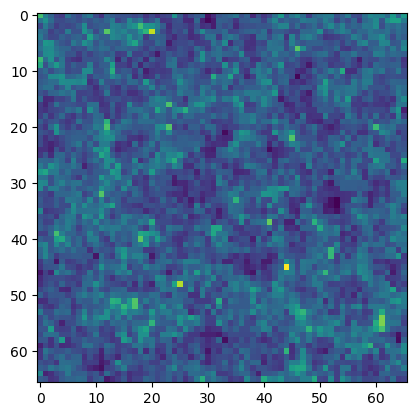

selected masks


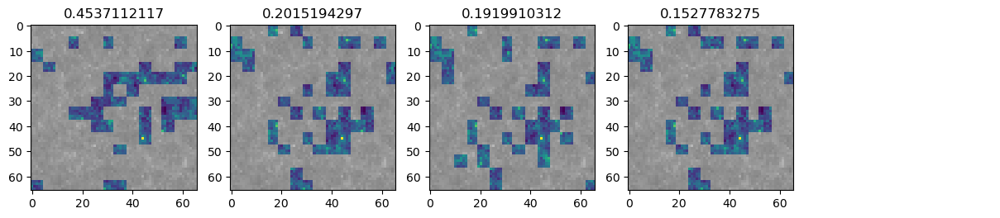

all masks


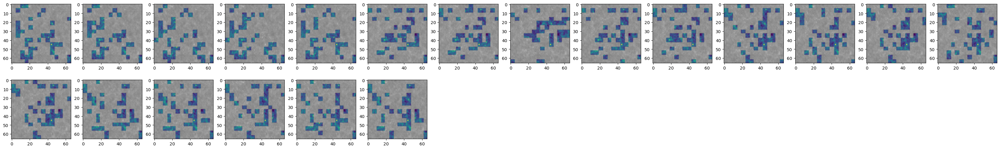

original


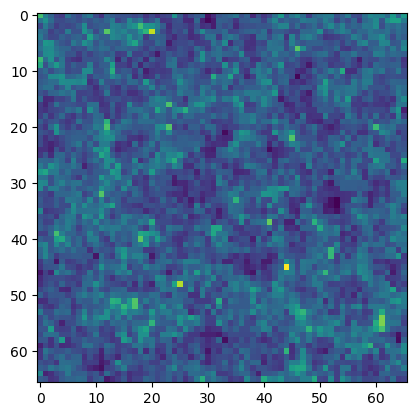

selected masks


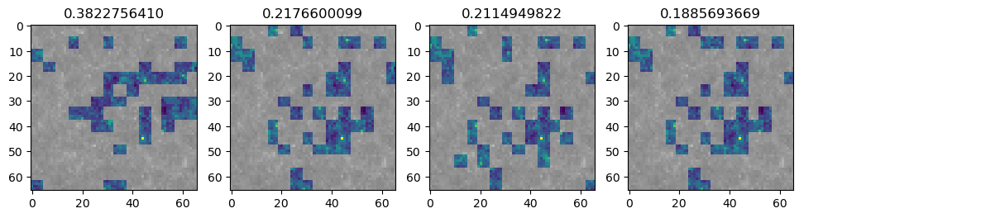

all masks


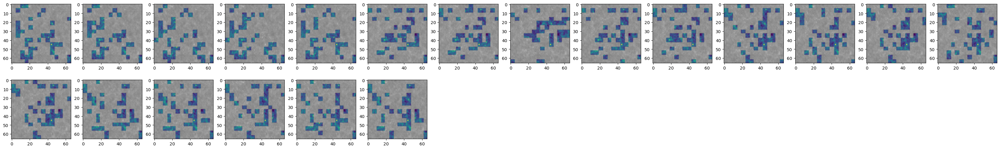

In [66]:
for bi, batch in enumerate(val_dataloader):
    if bi == 10:
        break
model.eval();
inputs, labels, masks, _ = batch
inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
masks = masks.to(device)
if seg == 'patch':
    masks = None
with torch.no_grad():
    outputs = model(inputs, masks, return_tuple=True, binary_threshold=-1)
show_masks_weights(inputs, outputs, pred=0)
show_masks_weights(inputs, outputs, pred=1)

original


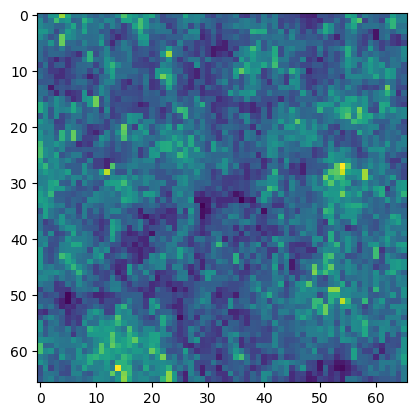

selected masks


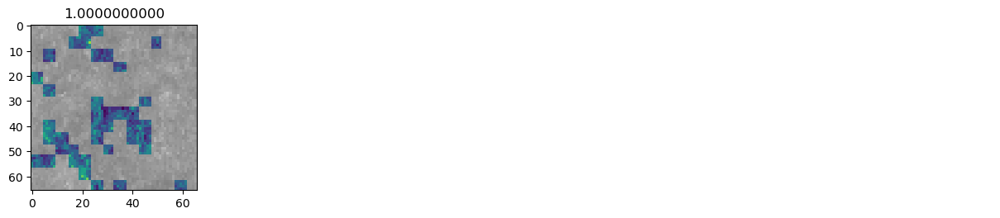

all masks


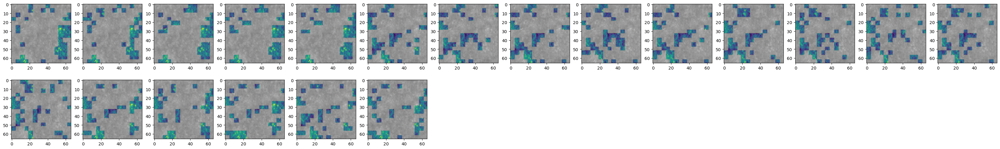

original


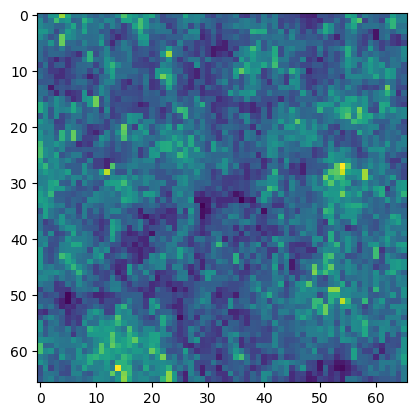

selected masks


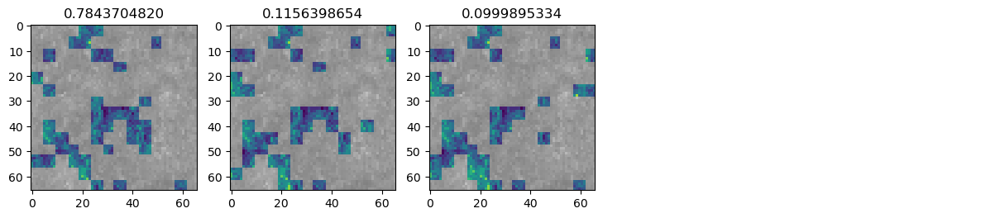

all masks


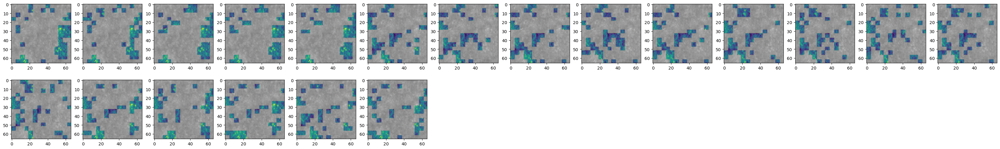

In [67]:
for bi, batch in enumerate(val_dataloader):
    if bi == 20:
        break
model.eval();
inputs, labels, masks, _ = batch
inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
masks = masks.to(device)
if seg == 'patch':
    masks = None
with torch.no_grad():
    outputs = model(inputs, return_tuple=True, binary_threshold=-1)
show_masks_weights(inputs, outputs)
show_masks_weights(inputs, outputs, pred=1)

original


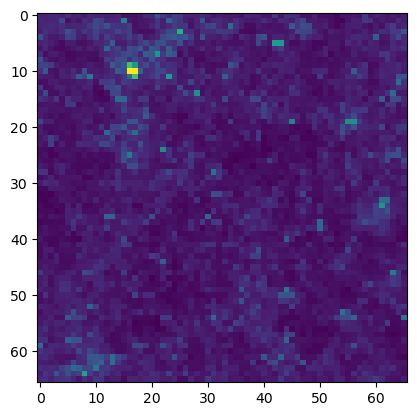

selected masks


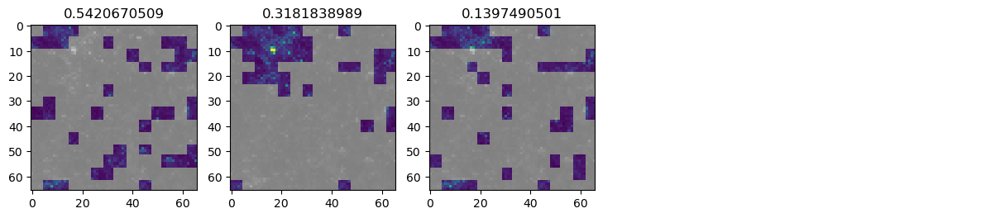

all masks


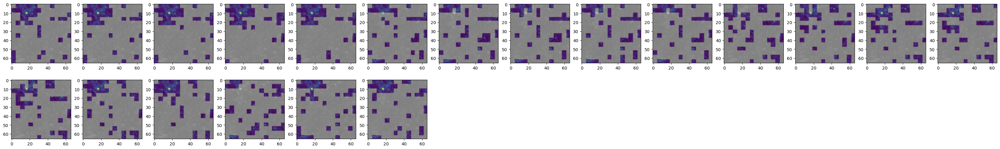

original


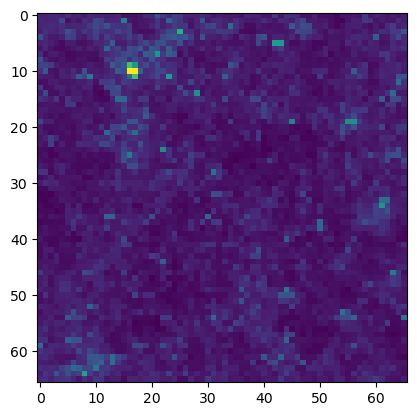

selected masks


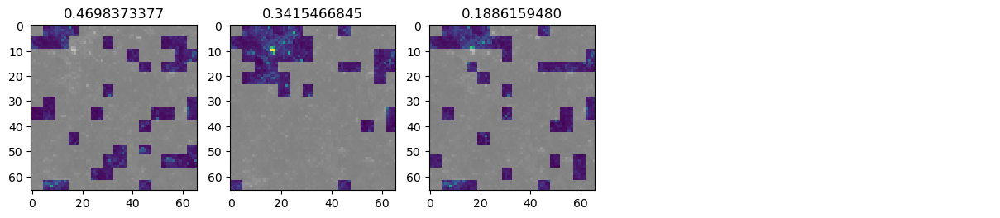

all masks


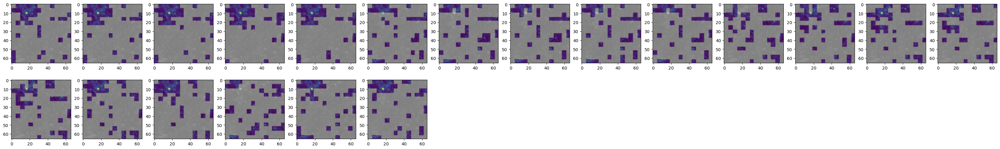

In [68]:
for bi, batch in enumerate(val_dataloader):
    if bi == 30:
        break
model.eval();
inputs, labels, masks, _ = batch
inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
masks = masks.to(device)
if seg == 'patch':
    masks = None
with torch.no_grad():
    outputs = model(inputs, return_tuple=True, binary_threshold=-1)
show_masks_weights(inputs, outputs)
show_masks_weights(inputs, outputs, pred=1)

# Purity

In [16]:
class Stats:
    def __init__(self):
        self.image = None
        self.label = None
        self.unique_masks = None
        self.all_masks = None
        self.summed_weights = None
        self.mean_logits = None
        
        self.frac_bright = []
        self.frac_dark = []
        self.omega_subset = []
        self.sigma_subset = []
        self.bright_subset = []
        self.dark_subset = []
        self.highweight_subset = []
        self.darkhighweight_omega_subset = []
        self.darkhighweight_sigma_subset = []
        self.brighthighweight_omega_subset = []
        self.brighthighweight_sigma_subset = []
        self.darkgoodloss_omega_subset = []
        self.darkgoodloss_sigma_subset = []
        self.brightgoodloss_omega_subset = []
        self.brightgoodloss_sigma_subset = []
        self.stds = []
        self.mask_weights_omega = []
        self.mask_weights_sigma = []
        self.mask_weight_total = {
            'dark': [0, 0],
            'bright': [0, 0]
        }
        self.mask_weight_list = {
            'dark': [[], []],
            'bright': [[], []]
        }
        
    def linearize(self):
        res_str = ''
        for k, v in self.__dict__.items():
            if k not in ['image', 'label', 'unique_masks', 'summed_weights', 'mean_logits', 'mask_intensities']:
                if isinstance(v, list) and len(v) > 0:
                    res_str += ' ' + k + ' ' + str(v)
        return res_str

In [17]:
def get_max_weighted_overlap_indices(outputs):
    # Example initialization, replace with actual data
    # N, M, H, W = 5, 10, 100, 100  # Adjust sizes as necessary
    N, M, H, W = outputs.masks.shape
    preds = outputs.logits.argmax(-1)
    masks = outputs.masks
    mask_weights = outputs.mask_weights[range(N),:,preds]

    # Compute pairwise overlaps
    # Resulting shape will be (N, M, M) since it computes the overlap within each example
    overlap = torch.einsum('nmhw,nkhw->nmk', masks, masks)

    # Set self-overlaps to zero
    indices = torch.arange(M)
    overlap[:, indices, indices] = 0

    # Weight the overlaps with the mask weights
    # mask_weights[:, :, None] broadcasts weights to (N, M, 1) for multiplication across M masks
    weighted_overlap = overlap * mask_weights[:, :, None]

    # Sum the weighted overlaps for each mask in each example
    total_weighted_overlap = weighted_overlap.sum(dim=2)

    # Find the mask index with the maximum weighted overlap for each example
    max_weighted_overlap_indices = torch.argmax(total_weighted_overlap, dim=1)

    # print("Indices of masks with the most weighted overlap per example:", max_weighted_overlap_indices)
    return max_weighted_overlap_indices

In [18]:
dataloader = test_dataloader

stats_all = []
progress_bar_eval = tqdm(range(len(dataloader)))
for bi, batch in enumerate(dataloader):
    if bi % 10 != 0:
        progress_bar_eval.update(1)
        continue
    # Now you can use `inputs` and `labels` in your training loop.
    inputs, labels, masks, _ = batch
    inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
    masks = masks.to(device)
    bsz = inputs.shape[0]
    if seg == 'patch':
        masks = None

    # break
    with torch.no_grad():
        outputs = model(inputs, masks, return_tuple=True)

    logits = outputs.logits

    for i in range(len(logits)):
        stats_single = Stats()
        stats_single.image = inputs[i]
        stats_single.label = labels[i]
        # stats_single.unique_masks = outputs.masks[i]
        stats_single.unique_masks = []
        stats_single.all_masks = []
        stats_single.mean_logits = logits[i]
        stats_single.all_masks = outputs.masks[i]

        for pred in range(2):
        # pred = 0
            # i = 0
            outputs_processed = get_masks_used(outputs, i=i, pred=pred)
            masks = outputs_processed['masks_sort_used']
            mask_weights = outputs_processed['mask_weights_sort_used']
            
            stats_single.unique_masks.append(masks)
            
            # import pdb; pdb.set_trace()



            DARK_THRESHOLD = 0
            BRIGHT_THRESHOLD = 3
            
            frac_brights = []
            frac_darks = []

            for j in range(len(masks)):
                mask = masks[j]
                mask_pth = mask 
                img_pth = inputs[i][0]
                sigma = img_pth.std()

                masked_img = img_pth*(mask_pth > 1e-4)
                # print('mask_pth', mask_pth.shape)
                # print('masked_img', masked_img.shape)
                mask_intensity = (masked_img[(mask_pth > 1e-4)].mean())

                frac_bright = (masked_img > BRIGHT_THRESHOLD*sigma).sum() / ((mask_pth > 1e-4).sum())
                frac_dark = (masked_img < DARK_THRESHOLD*sigma).sum() / ((mask_pth > 1e-4).sum()) * \
                            (mask_intensity < DARK_THRESHOLD*sigma)

                frac_brights.append(frac_bright.item())
                frac_darks.append(frac_dark.item())
            stats_single.frac_bright.append(frac_brights)
            stats_single.frac_dark.append(frac_darks)
            if pred == 0:
                stats_single.mask_weights_omega.append(mask_weights.cpu().numpy().tolist())
            else:
                stats_single.mask_weights_sigma.append(mask_weights.cpu().numpy().tolist())
            # break 

        stats_all.append(stats_single)
        # break
    progress_bar_eval.update(1)
    # break

  0%|          | 0/63 [00:00<?, ?it/s]

In [19]:
pred_mask_idxs_sort = outputs.mask_weights[i,:,pred].argsort(descending=True)
# mask_weights_sort = (outputs.mask_weights * outputs.logits_all)[i,pred_mask_idxs_sort,pred]
mask_weights_sort = outputs.mask_weights[i,pred_mask_idxs_sort,pred]
masks_sort = outputs.masks[0,pred_mask_idxs_sort]
masks_sort_used = (masks_sort[mask_weights_sort != 0] > 0).int()
mask_weights_sort_used = mask_weights_sort[mask_weights_sort != 0]
# return {
#     'masks_sort_used': masks_sort_used, 
#     'mask_weights_sort_used': mask_weights_sort_used
# }

In [48]:
outputs.mask_weights.shape

torch.Size([16, 20, 2])

In [49]:
outputs.masks.shape

torch.Size([16, 20, 66, 66])

In [50]:
stats_all[0].all_masks.shape, stats_all[0].unique_masks[0].shape

(torch.Size([20, 66, 66]), torch.Size([2, 66, 66]))

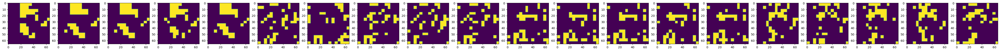

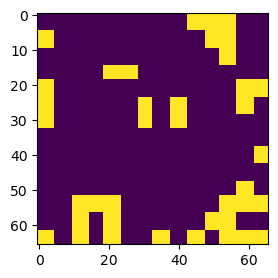

In [51]:
idx = 5

fig, axs = plt.subplots(1, len(stats_all[idx].all_masks), figsize=(len(stats_all[idx].all_masks)*3, 3))
for i in range(len(stats_all[idx].all_masks)):
    axs[i].imshow(stats_all[idx].all_masks[i].cpu())
plt.show()
fig, axs = plt.subplots(1, len(stats_all[idx].unique_masks[0]), 
                        figsize=(len(stats_all[idx].unique_masks[0])*3, 3))
for i in range(len(stats_all[idx].unique_masks[0])):
    try:
        axs[i].imshow(stats_all[idx].unique_masks[0][i].cpu())
    except:
        axs.imshow(stats_all[idx].unique_masks[0][i].cpu())
plt.show()

In [ ]:
max(omega_bright_flat)

NameError: name 'omega_bright_flat' is not defined

In [20]:
# results_sum_stats = {}
# for method in stats_all_results:
# print(method)
def flatten(xss):
    return [x for xs in xss for x in xs]
stats_all_comb = Stats()
for stat in tqdm(stats_all):
    for k, v in stat.__dict__.items():
        if k not in ['image', 'label', 'unique_masks', 'summed_weights', 'mean_logits']:
            if isinstance(v, list) and len(v) > 0:
                stats_all_comb.__dict__[k].append(v)
# print('cluster', len(stats_all_comb.bright_subset), 'void', len(stats_all_comb.dark_subset))
omega_bright_flat = flatten([item[0] for item in stats_all_comb.frac_bright])
omega_dark_flat = flatten([item[0] for item in stats_all_comb.frac_dark])
sigma_bright_flat = flatten([item[1] for item in stats_all_comb.frac_bright])
sigma_dark_flat = flatten([item[1] for item in stats_all_comb.frac_dark])
omega_weights_flat = flatten([item[0] for item in stats_all_comb.mask_weights_omega])
sigma_weights_flat = flatten([item[0] for item in stats_all_comb.mask_weights_sigma])

omega_bright_a = [item for item in omega_bright_flat if item > 0]
omega_dark_a = [item for item in omega_dark_flat if item > 0]
sigma_bright_a = [item for item in sigma_bright_flat if item > 0]
sigma_dark_a = [item for item in sigma_dark_flat if item > 0]

threshold_bright = 0.015
threshold_dark = 0.6
# threshold_bright = 0.01
# threshold_dark = 0.6
omega_bright = [item for item in omega_bright_a if item > threshold_bright]
omega_dark = [item for item in omega_dark_a if item > threshold_dark]
sigma_bright = [item for item in sigma_bright_a if item > threshold_bright]
sigma_dark = [item for item in sigma_dark_a if item > threshold_dark]
print('omega_bright', len(omega_bright), np.mean(omega_bright), len(omega_bright) / len(omega_bright_a))
print('omega_dark', len(omega_dark), np.mean(omega_dark), len(omega_dark) / len(omega_dark_a))
print('sigma_bright', len(sigma_bright), np.mean(sigma_bright), len(sigma_bright) / len(sigma_bright_a))
print('sigma_dark', len(sigma_dark), np.mean(sigma_dark), len(sigma_dark) / len(sigma_dark_a))

# how many really good groups in total are found?
mean_result = np.mean([
    len(omega_bright) / len(omega_bright_flat),
    len(omega_dark) / len(omega_dark_flat),
    len(sigma_bright) / len(omega_dark_flat),
    len(sigma_dark) / len(omega_dark_flat)
])

# pure_mean_result = np.mean([
#     len(omega_bright) / len(omega_bright_flat),
#     len(omega_dark) / len(omega_dark_flat),
#     len(sigma_bright) / len(omega_dark_flat),
#     len(sigma_dark) / len(omega_dark_flat)
# ])
# among the good groups found, how many are really good?
# mean_result = np.mean([
#     len(omega_bright) / len(omega_bright_a),
#     len(omega_dark) / len(omega_dark_a),
#     len(sigma_bright) / len(sigma_bright_a),
#     len(sigma_dark) / len(sigma_dark_a)
# ])

print(mean_result)
# print('Omega: cluster', len([fb[0] for fb in stats_all_comb.frac_bright if fb[0] > 0]), 'void', len([fd[0] for fd in stats_all_comb.frac_dark if fd[0] > 0]))
# print('Omega: cluster', np.mean([fb[0] for fb in stats_all_comb.frac_bright if fb[0] > 0]), 'void', np.mean([fd[0] for fd in stats_all_comb.frac_dark if fd[0] > 0]))
# print('Sigma: cluster', len([fb[1] for fb in stats_all_comb.frac_bright]), 'void', len([fd[1] for fd in stats_all_comb.frac_dark]))
# print('Sigma: cluster', np.mean([fb[1] for fb in stats_all_comb.frac_bright if fb[1] > 0]), 'void', np.mean([fd[1] for fd in stats_all_comb.frac_dark if fd[1] > 0]))
# print('cluster', np.mean(stats_all_comb.frac_bright), 'void', np.mean(stats_all_comb.frac_dark))
results_sop = {
    'omega_bright': {'count': len(omega_bright), 'mean': np.mean(omega_bright), 'std': np.std(omega_bright) },
    'omega_dark': {'count': len(omega_dark), 'mean': np.mean(omega_dark), 'std': np.std(omega_dark) },
    'sigma_bright': {'count': len(sigma_bright), 'mean': np.mean(sigma_bright), 'std': np.std(sigma_bright) },
    'sigma_dark': {'count': len(sigma_dark), 'mean': np.mean(sigma_dark), 'std': np.std(sigma_dark) },
    'mean': mean_result
}

  0%|          | 0/112 [00:00<?, ?it/s]

omega_bright 108 0.023617571030088044 0.45569620253164556
omega_dark 174 0.6640972755421167 0.9157894736842105
sigma_bright 133 0.023651356283659327 0.4554794520547945
sigma_dark 209 0.6627446991975228 0.9126637554585153
0.6473029045643154


In [54]:
with open('../neurips2024_figs/cosmogrid_sop_stats.json', 'wt') as output_file:
    json.dump(results_sop, output_file)

## more thresholds

In [27]:
# results_sum_stats = {}
# for method in stats_all_results:
# print(method)
def flatten(xss):
    return [x for xs in xss for x in xs]

def get_results(threshold_bright, threshold_dark):
# print('cluster', len(stats_all_comb.bright_subset), 'void', len(stats_all_comb.dark_subset))
# omega_bright_flat = flatten([item[0] for item in stats_all_comb.frac_bright])
# omega_dark_flat = flatten([item[0] for item in stats_all_comb.frac_dark])
# sigma_bright_flat = flatten([item[1] for item in stats_all_comb.frac_bright])
# sigma_dark_flat = flatten([item[1] for item in stats_all_comb.frac_dark])
# omega_weights_flat = flatten([item[0] for item in stats_all_comb.mask_weights_omega])
# sigma_weights_flat = flatten([item[0] for item in stats_all_comb.mask_weights_sigma])

# omega_bright_a = [item for item in omega_bright_flat if item > 0]
# omega_dark_a = [item for item in omega_dark_flat if item > 0]
# sigma_bright_a = [item for item in sigma_bright_flat if item > 0]
# sigma_dark_a = [item for item in sigma_dark_flat if item > 0]

# threshold_bright = 0.015
# threshold_dark = 0.6
# threshold_bright = 0.01
# threshold_dark = 0.6
    omega_bright = [item for item in omega_bright_a if item > threshold_bright]
    omega_dark = [item for item in omega_dark_a if item > threshold_dark]
    sigma_bright = [item for item in sigma_bright_a if item > threshold_bright]
    sigma_dark = [item for item in sigma_dark_a if item > threshold_dark]
    # print('omega_bright', len(omega_bright), np.mean(omega_bright), len(omega_bright) / len(omega_bright_a))
    # print('omega_dark', len(omega_dark), np.mean(omega_dark), len(omega_dark) / len(omega_dark_a))
    # print('sigma_bright', len(sigma_bright), np.mean(sigma_bright), len(sigma_bright) / len(sigma_bright_a))
    # print('sigma_dark', len(sigma_dark), np.mean(sigma_dark), len(sigma_dark) / len(sigma_dark_a))

    # how many really good groups in total are found?
    mean_result = np.mean([
        len(omega_bright) / len(omega_bright_flat),
        len(omega_dark) / len(omega_dark_flat),
        len(sigma_bright) / len(omega_dark_flat),
        len(sigma_dark) / len(omega_dark_flat)
    ])

    results_sop = {
        'omega_bright': {'count': len(omega_bright), 'mean': np.mean(omega_bright), 'std': np.std(omega_bright) },
        'omega_dark': {'count': len(omega_dark), 'mean': np.mean(omega_dark), 'std': np.std(omega_dark) },
        'sigma_bright': {'count': len(sigma_bright), 'mean': np.mean(sigma_bright), 'std': np.std(sigma_bright) },
        'sigma_dark': {'count': len(sigma_dark), 'mean': np.mean(sigma_dark), 'std': np.std(sigma_dark) },
        'mean': mean_result,
        'omega_bright_flat': omega_bright_flat,
        'omega_dark_flat': omega_dark_flat,
        'sigma_bright_flat': sigma_bright_flat,
        'sigma_dark_flat': sigma_dark_flat,
    }
    
    return results_sop

In [28]:
tbs = [0.005, 0.01, 0.015, 0.02, 0.025]
tds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

results_all_thresholds = {}

for threshold_bright in tbs:
    for threshold_dark in tds:
        res = get_results(threshold_bright, threshold_dark)
        results_all_thresholds[tuple([threshold_bright, threshold_dark])] = res

In [29]:
output_filename = '../neurips2024_figs/cosmogrid_sop_results_all_thresholds.pt'
torch.save(results_all_thresholds, output_filename)

In [55]:
results_sop_all = {
    'omega_bright_flat': omega_bright_flat,
    'omega_dark_flat': omega_dark_flat,
    'sigma_bright_flat': sigma_bright_flat,
    'sigma_dark_flat': sigma_dark_flat,
    'omega_weights_flat': omega_weights_flat,
    'sigma_weights_flat': sigma_weights_flat,
    'omega_bright': omega_bright,
    'omega_dark': omega_dark,
    'sigma_bright': sigma_bright,
    'sigma_dark': sigma_dark
}

for k, v in results_sop_all.items():
    print(k, len(v))

with open('../neurips2024_figs/cosmogrid_sop_stats_all.json', 'wt') as output_file:
    json.dump(results_sop_all, output_file)

omega_bright_flat 241
omega_dark_flat 241
sigma_bright_flat 297
sigma_dark_flat 297
omega_weights_flat 241
sigma_weights_flat 297
omega_bright 108
omega_dark 174
sigma_bright 133
sigma_dark 209


In [56]:
max(stats_all_comb.frac_bright)

[[0.06398104131221771,
  0.0559440553188324,
  0.06440281122922897,
  0.0620608888566494,
  0.060535505414009094],
 [0.06398104131221771,
  0.0559440553188324,
  0.06440281122922897,
  0.0620608888566494,
  0.060535505414009094]]

In [57]:
max(omega_bright_flat), max(sigma_bright_flat)

(0.06440281122922897, 0.06440281122922897)

## Void

In [21]:
max(omega_dark_flat), max(sigma_dark_flat), min(omega_dark_flat), min(sigma_dark_flat)

(0.839243471622467, 0.839243471622467, 0.0, 0.0)

In [22]:
np.mean(omega_dark_flat)

0.518329043358688

In [23]:
from tqdm.auto import tqdm

dark_min = 0.75
bright_min = 0.03

dark_idxs = []
for i in tqdm(range(len(stats_all))):
    for fb in flatten(stats_all[i].frac_dark):
        if fb > dark_min:
            dark_idxs.append(i)
            break




bright_idxs = []
for i in tqdm(range(len(stats_all))):
    for fb in flatten(stats_all[i].frac_bright):
        if fb > bright_min:
            bright_idxs.append(i)
            break
            
print('dark_idxs', dark_idxs, 'bright_idxs', bright_idxs)

dark_and_bright = set(dark_idxs) & set(bright_idxs)
print(dark_and_bright)

  0%|          | 0/112 [00:00<?, ?it/s]

  0%|          | 0/112 [00:00<?, ?it/s]

dark_idxs [2, 6, 31, 33, 46, 53, 66, 99, 100] bright_idxs [18, 19, 49, 70, 75, 106, 107]
set()


2


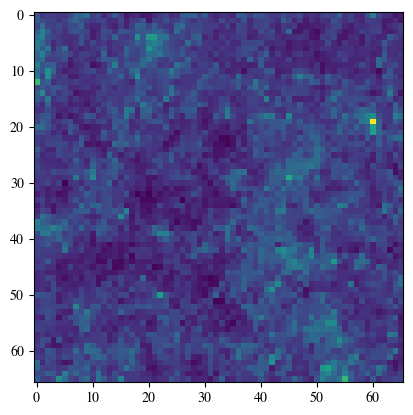

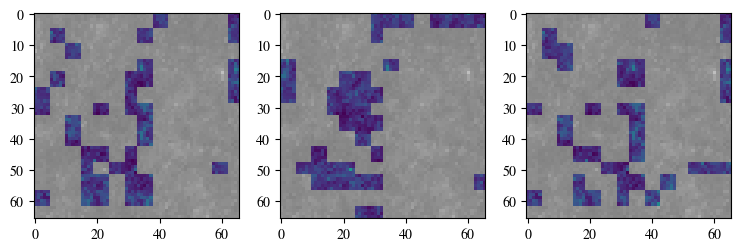

6


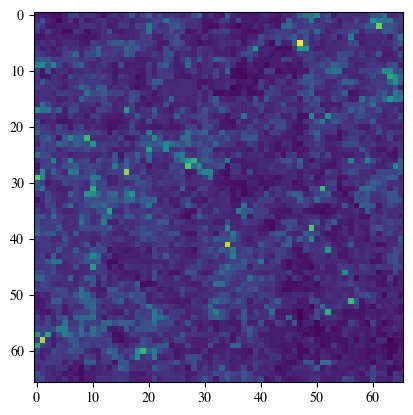

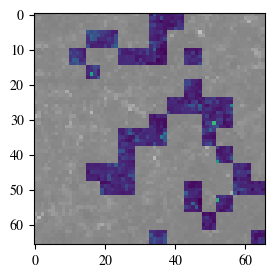

31


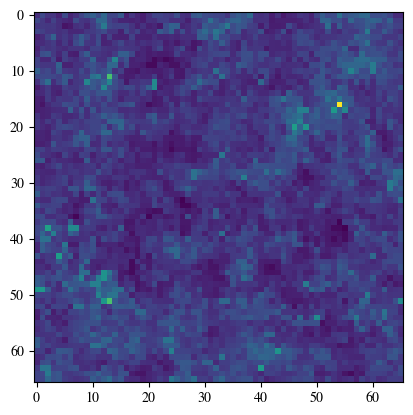

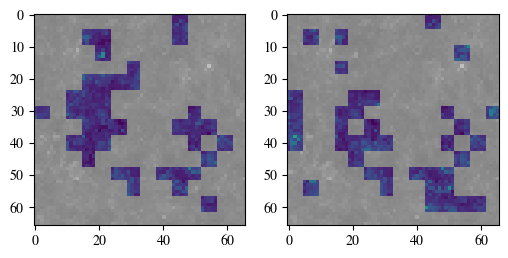

33


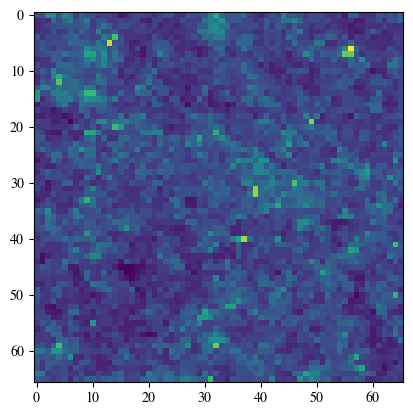

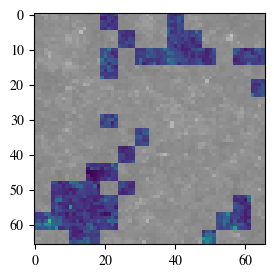

46


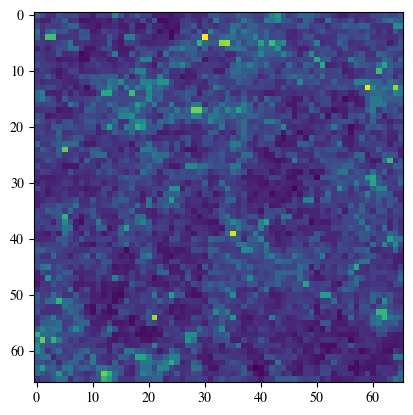

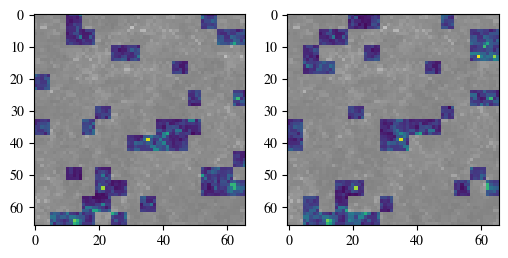

53


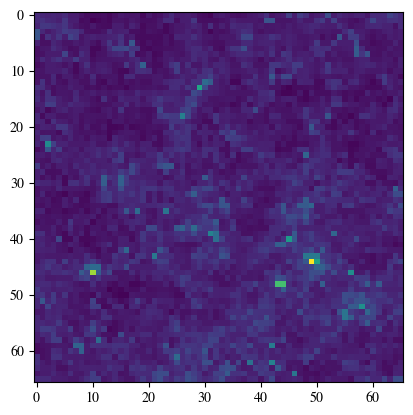

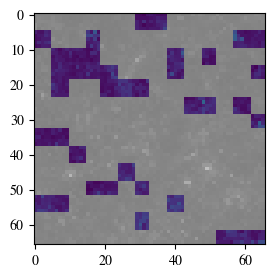

66


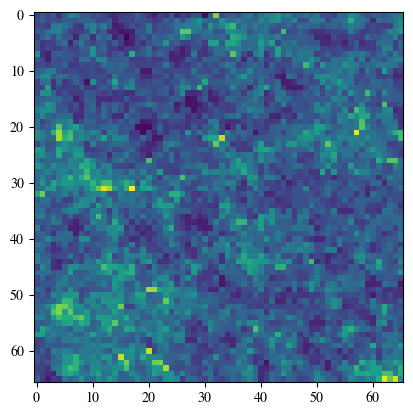

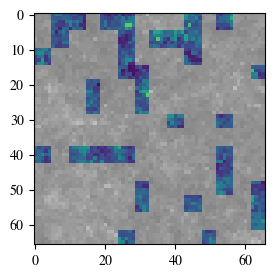

99


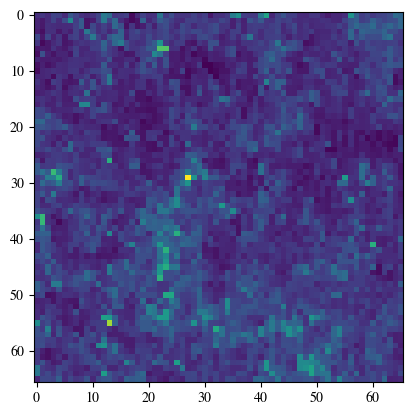

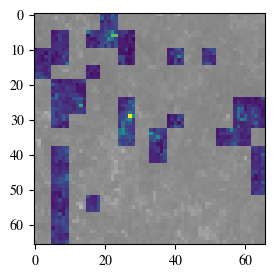

100


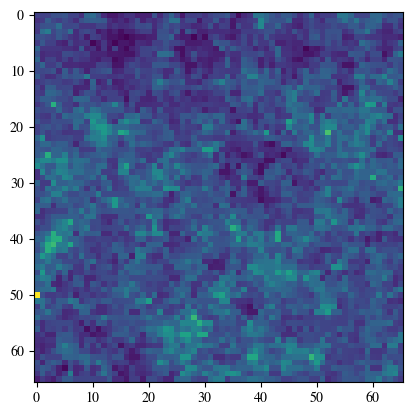

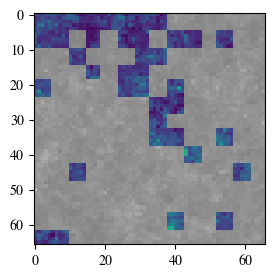

In [25]:
# idx = list(dark_and_bright)[2]

for idx in dark_idxs:
    print(idx)
    plt.figure()
    plt.imshow(stats_all[idx].image[0].cpu().numpy())
    plt.show()
    fig, axs = plt.subplots(1, len(stats_all[idx].unique_masks[0]), 
                            figsize=(len(stats_all[idx].unique_masks[0])*3, 3))
    
    for j in range(len(stats_all[idx].unique_masks[0])):
        # plt.figure()
        try:
            map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   axs[j])
        except:
            map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   axs)
        # plt.title(f'{j}')
    plt.show()
    

In [361]:
idx = 70
for j in range(len(stats_all[idx].unique_masks[0])):
    print(stats_all[idx].unique_masks[0][j].float().mean())
    print(stats_all[idx].frac_bright[0][j])
    print(stats_all[idx].frac_dark[0][j])

tensor(0.2091, device='cuda:0')
0.012074642814695835
0.6673984527587891
tensor(0.2025, device='cuda:0')
0.01473922934383154
0.6099773049354553
tensor(0.1993, device='cuda:0')
0.01036866381764412
0.6440092325210571
tensor(0.2036, device='cuda:0')
0.041713640093803406
0.0


In [26]:
idx = 31
for j in range(len(stats_all[idx].unique_masks[0])):
    print(stats_all[idx].unique_masks[0][j].float().mean())
    print(stats_all[idx].frac_bright[0][j])
    print(stats_all[idx].frac_dark[0][j])

tensor(0.1951, device='cuda:0')
0.0035294117406010628
0.7611764669418335
tensor(0.1965, device='cuda:0')
0.009345794096589088
0.6366822719573975


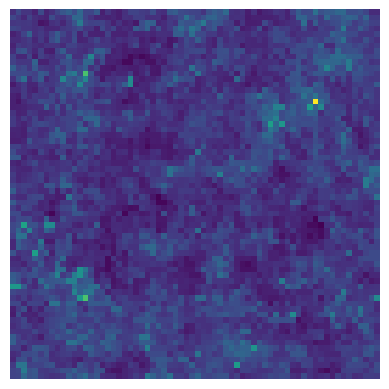

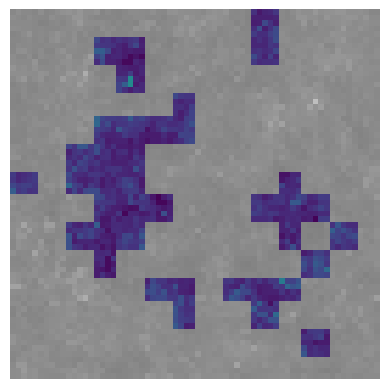

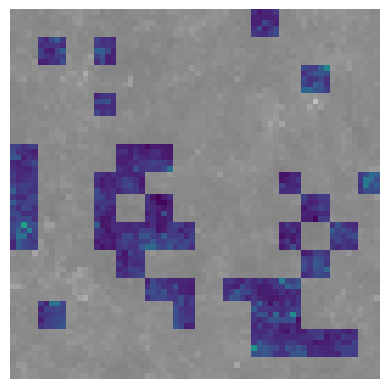

In [27]:
idx = 31
j_void = 0
j_cluster = 1

plt.figure()
plt.imshow(stats_all[idx].image[0].cpu().numpy())
plt.axis('off')
plt.savefig(f'../neurips2024_figs/original_idx{idx}.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

plt.figure()
map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j_void].cpu().numpy(),
                   plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/void_idx{idx}_jvoid{j_void}_fb{stats_all[idx].frac_bright[0][j_void]:.4f}_fd{stats_all[idx].frac_dark[0][j_void]:.4f}.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

plt.figure()
map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j_cluster].cpu().numpy(),
                   plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/cluster_idx{idx}_jvoid{j_cluster}_fb{stats_all[idx].frac_bright[0][j_cluster]:.4f}_fd{stats_all[idx].frac_dark[0][j_cluster]:.4f}.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

In [79]:
def show_masked_img(img, mask, ax):
    ax.imshow(img.cpu().numpy())
    # ax.imshow(mask.cpu().numpy(), cmap='hot', alpha=0.5)
    ax.contour(mask.cpu().numpy(), 1, colors='white', linestyles='-')
    ax.contourf(mask.cpu().numpy(), 1, hatches=['/', None, None],
                cmap='gray', extend='neither', linestyles='-', alpha=0.01)
    ax.axis('off')

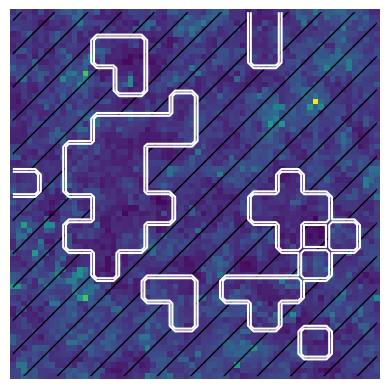

In [80]:
show_masked_img(stats_all[idx].image[0], stats_all[idx].unique_masks[0][j_void], plt)

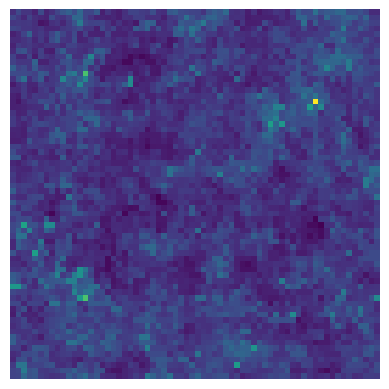

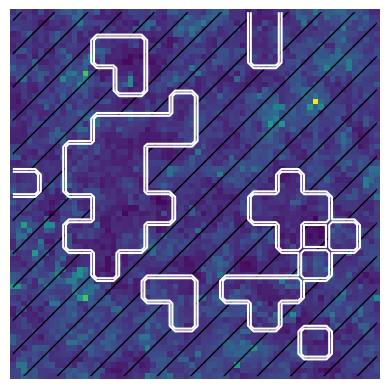

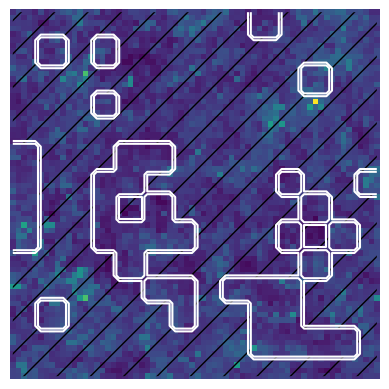

In [85]:
idx = 31
j_void = 0
j_cluster = 1

plt.figure()
plt.imshow(stats_all[idx].image[0].cpu().numpy())
plt.axis('off')
plt.savefig(f'../neurips2024_figs/original_idx{idx}.png', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

plt.figure()
# map_plotter(stats_all[idx].image[0].cpu().numpy(), 
#                     stats_all[idx].unique_masks[0][j_void].cpu().numpy(),
#                    plt, type='contour')
show_masked_img(stats_all[idx].image[0], stats_all[idx].unique_masks[0][j_void], plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/void_idx{idx}_jvoid{j_void}_fb{stats_all[idx].frac_bright[0][j_void]:.4f}_fd{stats_all[idx].frac_dark[0][j_void]:.4f}_contour.png', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

plt.figure()
show_masked_img(stats_all[idx].image[0], stats_all[idx].unique_masks[0][j_cluster], plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/cluster_idx{idx}_jvoid{j_cluster}_fb{stats_all[idx].frac_bright[0][j_cluster]:.4f}_fd{stats_all[idx].frac_dark[0][j_cluster]:.4f}_contour.png', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

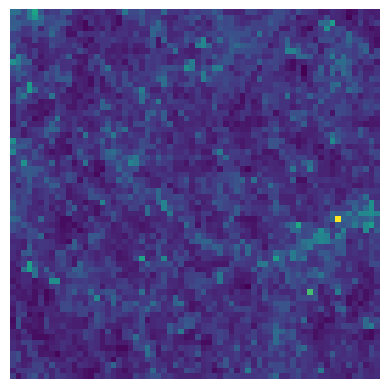

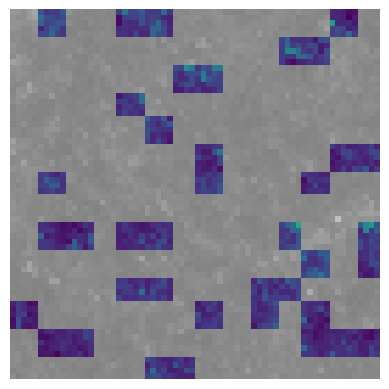

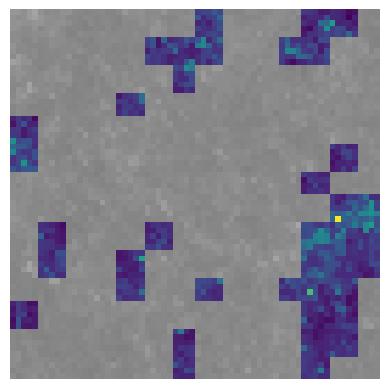

In [372]:
idx = 70
j_void = 1
j_cluster = 3

plt.figure()
plt.imshow(stats_all[idx].image[0].cpu().numpy())
plt.axis('off')
plt.savefig(f'../neurips2024_figs/original_idx{idx}.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

plt.figure()
map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j_void].cpu().numpy(),
                   plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/void_idx{idx}_jvoid{j_void}_fb{stats_all[idx].frac_bright[0][j_void]:.4f}_fd{stats_all[idx].frac_dark[0][j_void]:.4f}.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

plt.figure()
map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j_cluster].cpu().numpy(),
                   plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/cluster_idx{idx}_jvoid{j_cluster}_fb{stats_all[idx].frac_bright[0][j_cluster]:.4f}_fd{stats_all[idx].frac_dark[0][j_cluster]:.4f}.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

In [362]:
idx = 49
for j in range(len(stats_all[idx].unique_masks[0])):
    print(stats_all[idx].unique_masks[0][j].float().mean())
    print(stats_all[idx].frac_bright[0][j])
    print(stats_all[idx].frac_dark[0][j])

tensor(0.1995, device='cuda:0')
0.025316456332802773
0.0
tensor(0.2004, device='cuda:0')
0.04581901431083679
0.0
tensor(0.1972, device='cuda:0')
0.017462166026234627
0.0


## Cluster

18


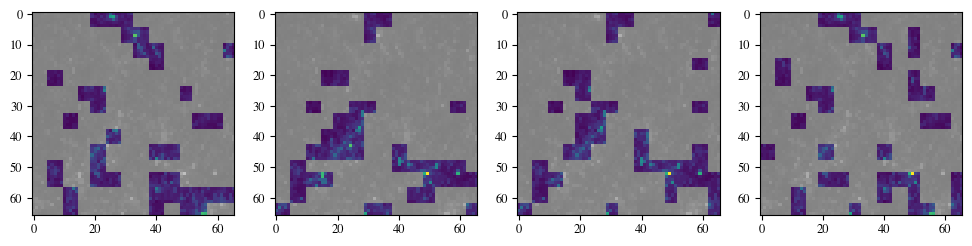

19


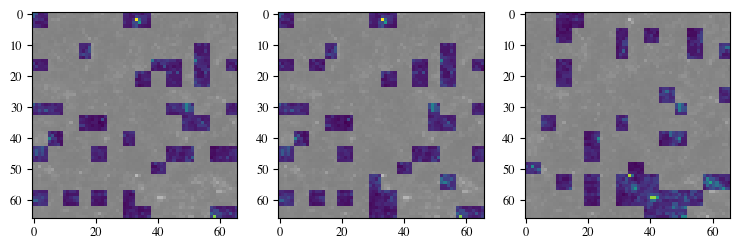

49


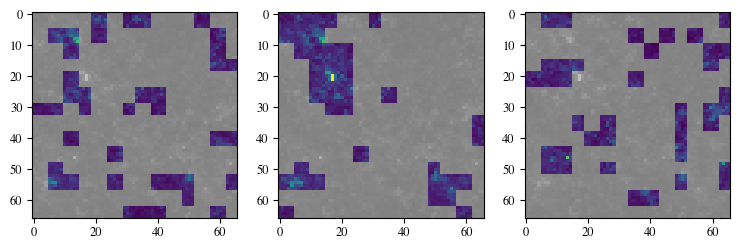

70


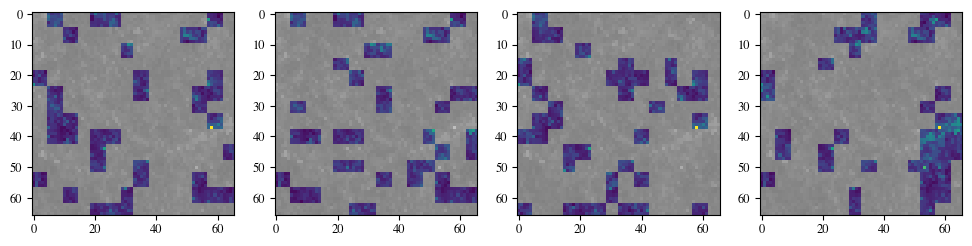

75


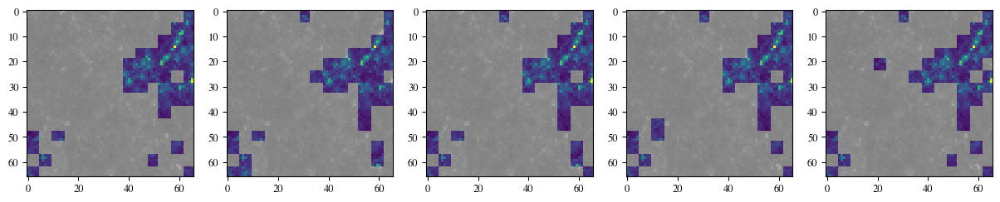

106


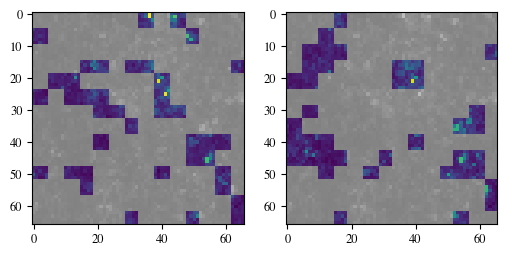

107


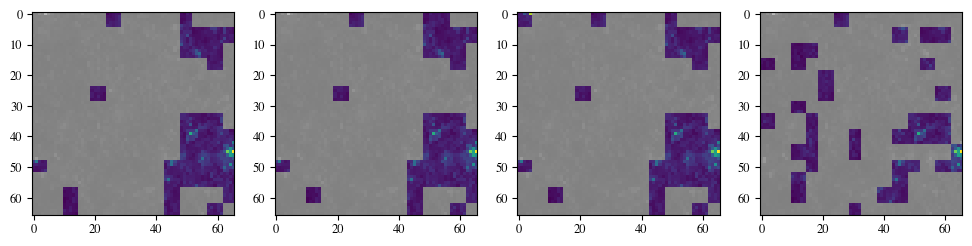

In [353]:
# clusters

for idx in bright_idxs:
    print(idx)
    fig, axs = plt.subplots(1, len(stats_all[idx].unique_masks[0]), 
                            figsize=(len(stats_all[idx].unique_masks[0])*3, 3))
    for j in range(len(stats_all[idx].unique_masks[0])):
        # plt.figure()
        try:
            map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   axs[j])
        except:
            map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   axs)
        # plt.title(f'{j}')
    plt.show()
    

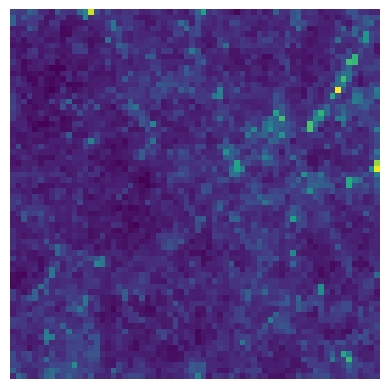

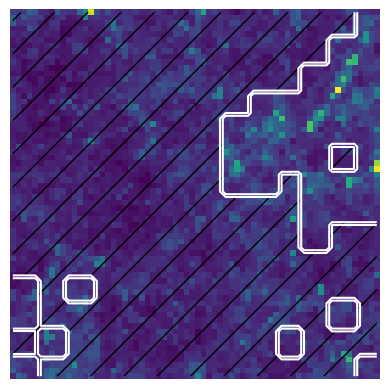

In [86]:
idx = 75
# j_void = 0
j_cluster = 0

plt.figure()
plt.imshow(stats_all[idx].image[0].cpu().numpy())
plt.axis('off')
plt.savefig(f'../neurips2024_figs/original_idx{idx}.png', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

# plt.figure()
# # map_plotter(stats_all[idx].image[0].cpu().numpy(), 
# #                     stats_all[idx].unique_masks[0][j_void].cpu().numpy(),
# #                    plt, type='contour')
# show_masked_img(stats_all[idx].image[0], stats_all[idx].unique_masks[0][j_void], plt)
# plt.axis('off')
# plt.savefig(f'../neurips2024_figs/void_idx{idx}_jvoid{j_void}_fb{stats_all[idx].frac_bright[0][j_void]:.4f}_fd{stats_all[idx].frac_dark[0][j_void]:.4f}_contour.pdf', dpi=300, bbox_inches='tight', pad_inches=0)
# plt.show()

plt.figure()
show_masked_img(stats_all[idx].image[0], stats_all[idx].unique_masks[0][j_cluster], plt)
plt.axis('off')
plt.savefig(f'../neurips2024_figs/cluster_idx{idx}_jcluster{j_cluster}_fb{stats_all[idx].frac_bright[0][j_cluster]:.4f}_fd{stats_all[idx].frac_dark[0][j_cluster]:.4f}_contour.png', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

63


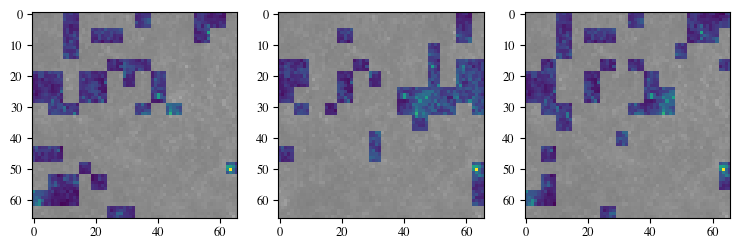

In [349]:
# idx = list(dark_and_bright)[2]

for idx in dark_and_bright:
    print(idx)
    fig, axs = plt.subplots(1, len(stats_all[idx].unique_masks[0]), 
                            figsize=(len(stats_all[idx].unique_masks[0])*3, 3))
    for j in range(len(stats_all[idx].unique_masks[0])):
        # plt.figure()
        try:
            map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   axs[j])
        except:
            map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   axs)
        # plt.title(f'{j}')
    plt.show()
    

idx 46


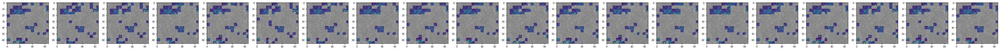

hi
idx 46


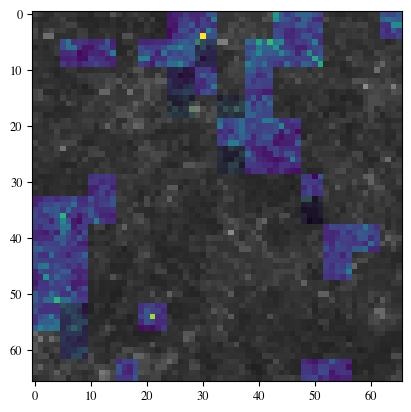

idx 53


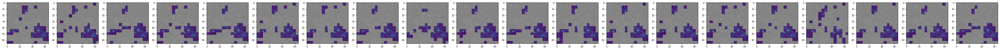

hi
idx 53


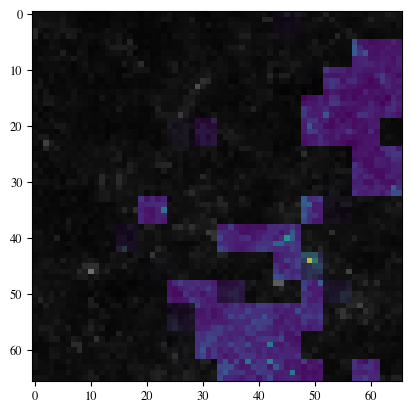

idx 54


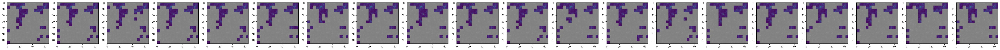

hi
idx 54


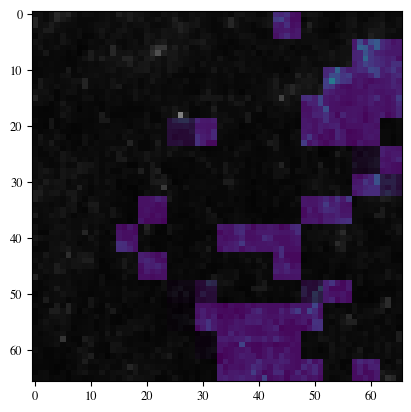

idx 66


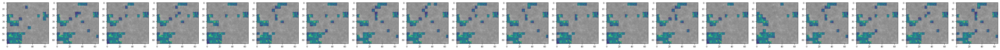

hi
idx 66


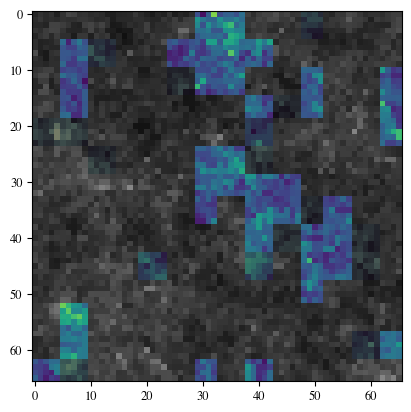

idx 68


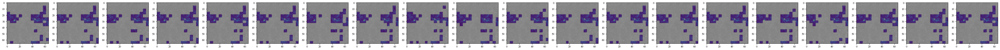

hi
idx 68


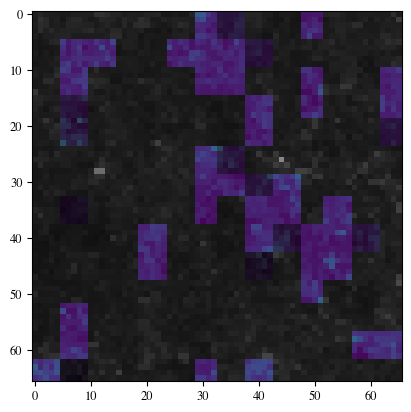

idx 94


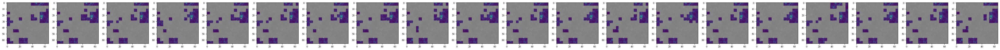

hi
idx 94


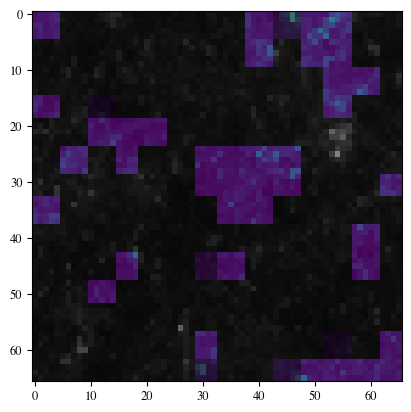

idx 97


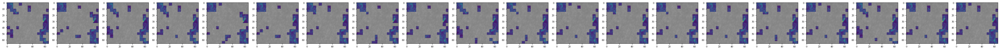

hi
idx 97


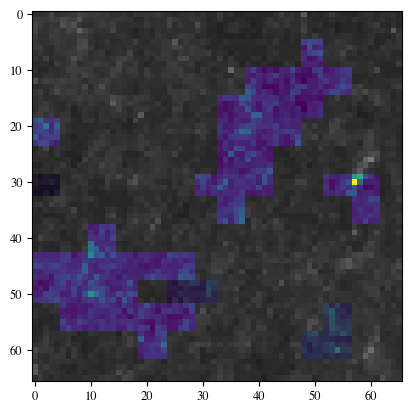

idx 103


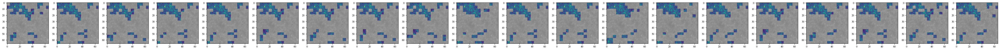

hi
idx 103


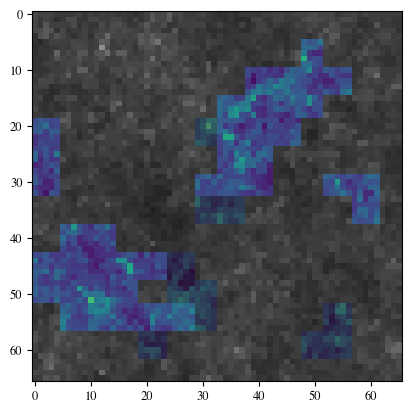

In [299]:
# idx = list(dark_and_bright)[2]

for idx in dark_idxs:
    fig, axs = plt.subplots(1, len(stats_all[idx].all_masks), figsize=(len(stats_all[idx].all_masks)*3, 3))
    print('idx', idx)
    for j in range(len(stats_all[idx].all_masks)):
        # plt.figure()
        map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].all_masks[j].cpu().numpy(),
                   axs[j])
        # plt.title(f'{j}')
    plt.show()
    print('hi')
    print('idx', idx)
    plt.figure()
    for j in range(len(stats_all[idx].unique_masks[0])):
        # plt.figure()
        map_plotter(stats_all[idx].image[0].cpu().numpy(), 
                    stats_all[idx].unique_masks[0][j].cpu().numpy(),
                   plt)
        # plt.title(f'{j}')
    plt.show()

In [296]:
len(stats_all[idx].unique_masks[0])

1

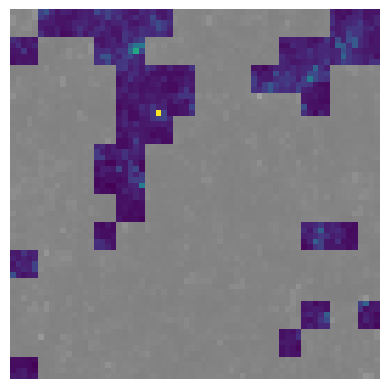

In [294]:
idxs = dark_idxs
idx = 2
map_plotter(stats_all[idxs[idx]].image[0].cpu().numpy(), 
            stats_all[idxs[idx]].all_masks[0].cpu().numpy())
plt.axis('off')
plt.savefig('../neurips2024_figs/void.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

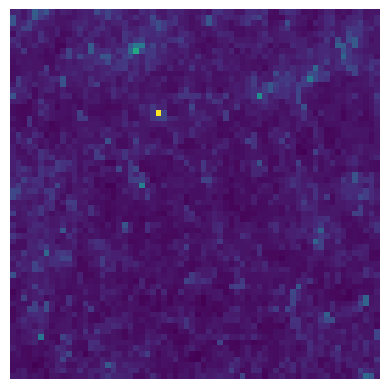

In [293]:
plt.imshow(stats_all[idxs[idx]].image[0].cpu())
plt.axis('off')
plt.savefig('../neurips2024_figs/weak_lensing_map.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

# Cluster

In [190]:
from tqdm.auto import tqdm

bright_min = 0.045

bright_idxs = []
for i in tqdm(range(len(stats_all))):
    for fb in flatten(stats_all[i].frac_bright):
        if fb > bright_min:
            bright_idxs.append(i)
            break

  0%|          | 0/112 [00:00<?, ?it/s]

In [191]:
bright_idxs

[48]

In [195]:
stats_all[bright_idxs[0]].__dict__.keys()

dict_keys(['image', 'label', 'unique_masks', 'summed_weights', 'mean_logits', 'frac_bright', 'frac_dark', 'omega_subset', 'sigma_subset', 'bright_subset', 'dark_subset', 'highweight_subset', 'darkhighweight_omega_subset', 'darkhighweight_sigma_subset', 'brighthighweight_omega_subset', 'brighthighweight_sigma_subset', 'darkgoodloss_omega_subset', 'darkgoodloss_sigma_subset', 'brightgoodloss_omega_subset', 'brightgoodloss_sigma_subset', 'stds', 'mask_weights_omega', 'mask_weights_sigma', 'mask_weight_total', 'mask_weight_list'])

In [29]:
import matplotlib.pyplot as plt
import matplotlib
from scipy.ndimage import binary_dilation
from skimage import measure


def map_plotter(image, mask, ax=plt, type='dim'): 
    default_cmap = matplotlib.rcParams['image.cmap']
    cmap = plt.get_cmap(default_cmap)
    gray_cmap = plt.get_cmap('gray')
    
    norm = plt.Normalize()
    normed_image = norm(image)
    # normed_image = np.clip((image - img_min) / (img_max - img_min) * 3, 0, 1)
    rgb_image = cmap(normed_image)
    if type == 'dim':
        gray_image = (gray_cmap(normed_image) / 2)
        mask_bool = np.repeat((mask > 0)[:,:,None], 4, axis=-1)
        gray_image[mask_bool] = rgb_image[mask_bool]
        ax.imshow(gray_image)
    elif type == 'contour':
        # 1. Find the contours of the mask
        mask_bool = (mask > 0).astype(np.float32)
        dilated_mask_bool = binary_dilation(mask_bool)
        contours_original = measure.find_contours(mask_bool, 0.5)
        contours_dilated = measure.find_contours(dilated_mask_bool, 0.51)

        # 2. Overlay the contours on top of the original image
        # fig, ax = plt.subplots()
        ax.imshow(rgb_image)

        for contour in contours_dilated:
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')  # color can be changed as needed

        for contour in contours_original:
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')  # color can be changed as needed

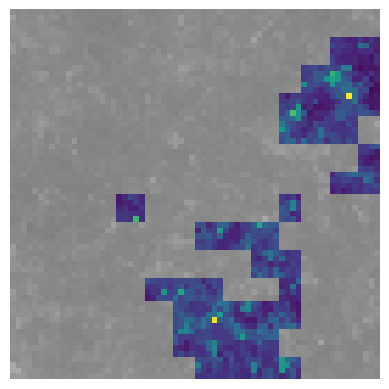

In [235]:
map_plotter(stats_all[bright_idxs[0]].image[0].cpu().numpy(), 
            stats_all[bright_idxs[0]].unique_masks[0][0].cpu().numpy())
plt.axis('off')
plt.savefig('../neurips2024_figs/cluster.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

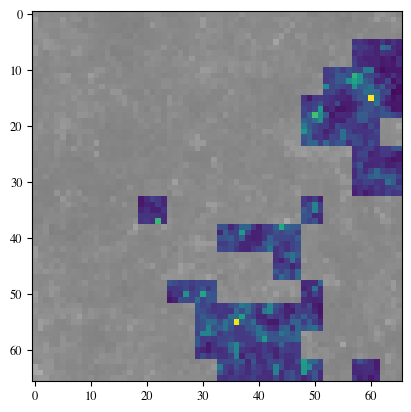

In [236]:
map_plotter(stats_all[bright_idxs[0]].image[0].cpu().numpy(), 
            stats_all[bright_idxs[0]].unique_masks[0][1].cpu().numpy())

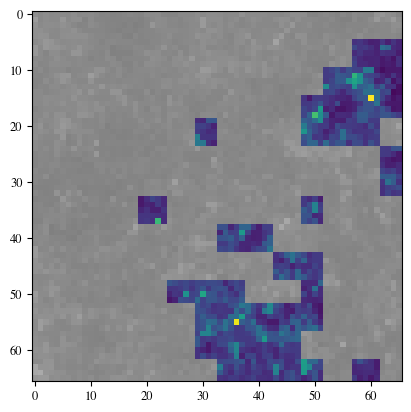

In [237]:
map_plotter(stats_all[bright_idxs[0]].image[0].cpu().numpy(), 
            stats_all[bright_idxs[0]].unique_masks[0][2].cpu().numpy())

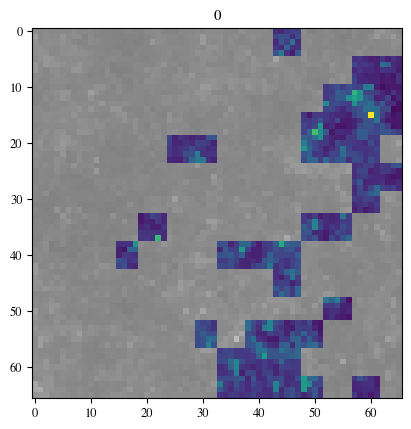

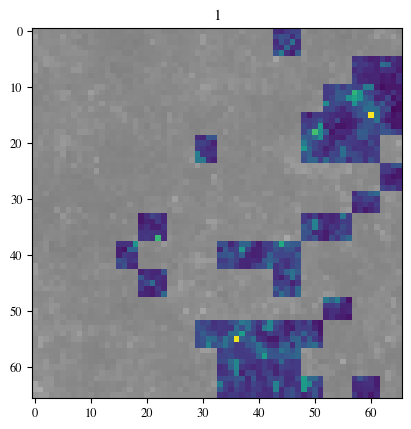

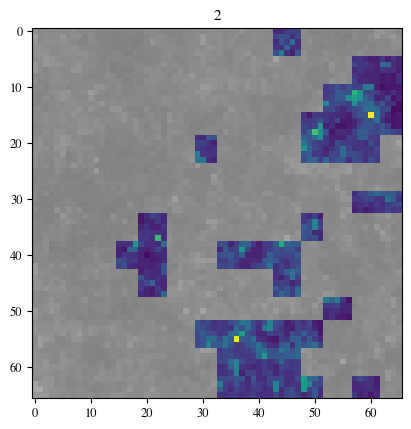

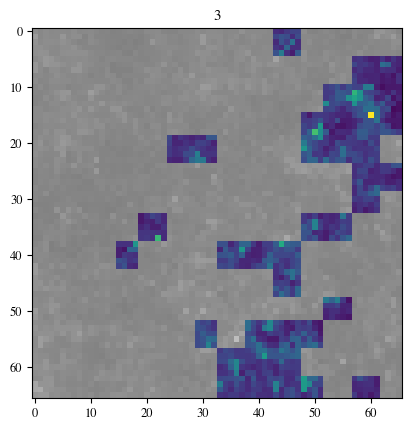

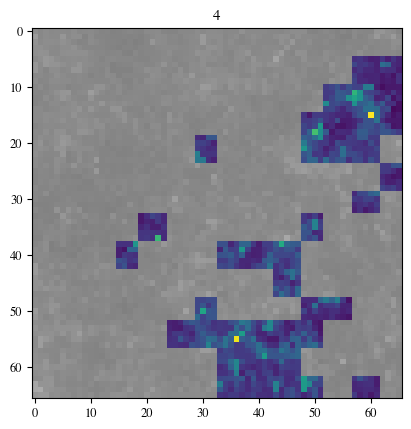

...

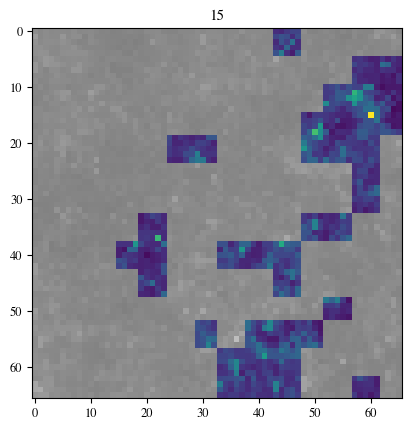

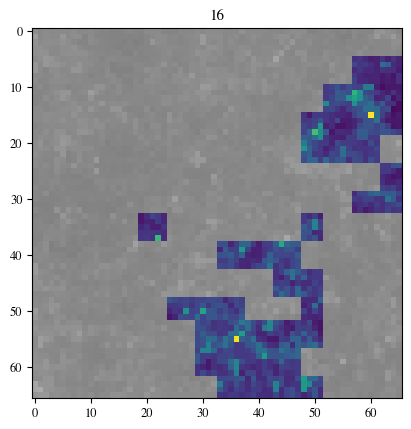

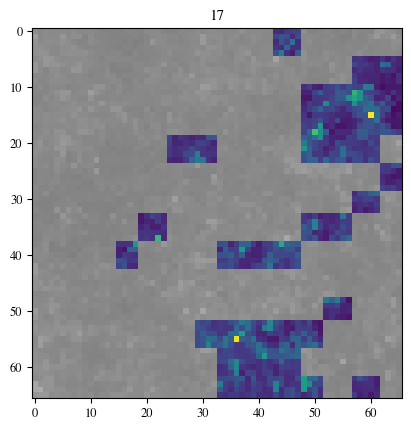

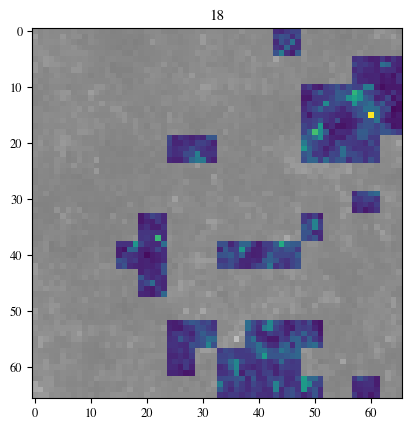

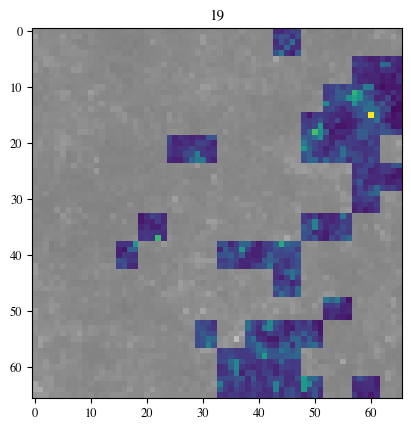

In [ ]:
for j in range(len(stats_all[bright_idxs[0]].all_masks)):
    plt.figure()
    map_plotter(stats_all[bright_idxs[0]].image[0].cpu().numpy(), 
                stats_all[bright_idxs[0]].all_masks[j].cpu().numpy())
    plt.title(f'{j}')
    plt.show()

In [242]:
stats_all[bright_idxs[0]].all_masks.shape

torch.Size([20, 66, 66])

(array([125., 133.,  91.,  54.,  28.,  22.,  10.,   9.,   2.,   6.]),
 array([6.72280788e-04, 1.00605053e-01, 2.00537825e-01, 3.00470597e-01,
        4.00403368e-01, 5.00336140e-01, 6.00268912e-01, 7.00201684e-01,
        8.00134456e-01, 9.00067228e-01, 1.00000000e+00]),
 <BarContainer object of 10 artists>)

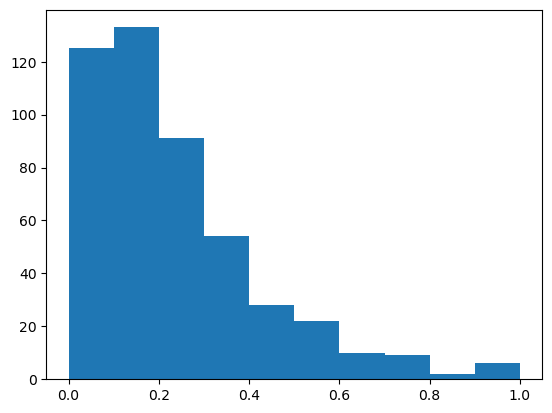

In [ ]:
import matplotlib.pyplot as plt

plt.hist(omega_weights_flat)

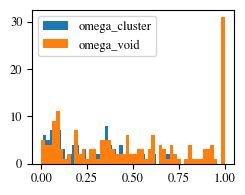

In [373]:
import matplotlib.pyplot as plt
n_bins = 50

plt.figure(figsize=(2.6, 2))
plt.hist([omega_weights_flat[i] for i in range(len(omega_bright_flat)) if omega_bright_flat[i] > threshold_bright],
        label='omega_cluster', bins=n_bins)
plt.hist([omega_weights_flat[i] for i in range(len(omega_dark_flat)) if omega_dark_flat[i] > threshold_dark],
        label='omega_void', bins=n_bins)
plt.legend()

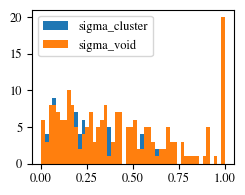

In [374]:
plt.figure(figsize=(2.6, 2))
plt.hist([sigma_weights_flat[i] for i in range(len(sigma_bright_flat)) if sigma_bright_flat[i] > threshold_bright],
        label='sigma_cluster', bins=n_bins)
plt.hist([sigma_weights_flat[i] for i in range(len(sigma_dark_flat)) if sigma_dark_flat[i] > threshold_dark],
        label='sigma_void', bins=n_bins)

plt.legend()

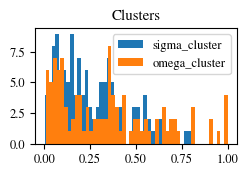

In [375]:
plt.rcParams['font.size'] = 9  # Sets the default font size to 9
plt.rcParams['font.family'] = 'STIXGeneral'
plt.figure(figsize=(2.6, 1.5))
plt.hist([sigma_weights_flat[i] for i in range(len(sigma_bright_flat)) if sigma_bright_flat[i] > threshold_bright],
        label='sigma_cluster', bins=n_bins)
plt.hist([omega_weights_flat[i] for i in range(len(omega_bright_flat)) if omega_bright_flat[i] > threshold_bright],
        label='omega_cluster', bins=n_bins)
plt.title('Clusters')
plt.legend()
plt.savefig('../neurips2024_figs/cosmogrid_clusters.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

/opt/conda/envs/rapids/lib/python3.10/site-packages/numpy/lib/histograms.py:906: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


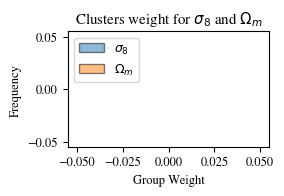

In [383]:
import matplotlib.pyplot as plt

# Your existing setup
plt.figure(figsize=(2.6, 1.5))

# Assuming sigma_weights_flat, sigma_dark_flat, omega_weights_flat, omega_dark_flat are defined
# and threshold_dark and n_bins are also defined

# Histogram for sigma_void
plt.hist([sigma_weights_flat[i] for i in range(len(sigma_bright_flat)) if sigma_bright_flat[i] > threshold_dark],
         label=r'$\sigma_8$', bins=n_bins, density=True, alpha=0.5, edgecolor='black')

# Histogram for omega_void
plt.hist([omega_weights_flat[i] for i in range(len(omega_bright_flat)) if omega_bright_flat[i] > threshold_dark],
         label=r'$\Omega_m$', bins=n_bins, density=True, alpha=0.5, edgecolor='black')

# Adding labels and title
plt.title('Clusters weight for $\sigma_8$ and $\Omega_m$')
plt.xlabel('Group Weight')
plt.ylabel('Frequency')
plt.legend()

# Saving the figure
plt.savefig('../neurips2024_figs/cosmogrid_clusters.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

# Show the plot
plt.show()


In [376]:
np.mean([sigma_weights_flat[i] for i in range(len(sigma_bright_flat)) if sigma_bright_flat[i] > threshold_bright]), np.mean([omega_weights_flat[i] for i in range(len(omega_bright_flat)) if omega_bright_flat[i] > threshold_bright])

(0.2836546664362523, 0.34014147161333647)

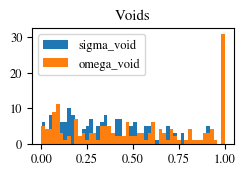

In [377]:
plt.figure(figsize=(2.6, 1.5))
plt.hist([sigma_weights_flat[i] for i in range(len(sigma_dark_flat)) if sigma_dark_flat[i] > threshold_dark],
        label='sigma_void', bins=n_bins)
plt.hist([omega_weights_flat[i] for i in range(len(omega_dark_flat)) if omega_dark_flat[i] > threshold_dark],
        label='omega_void', bins=n_bins)
plt.title('Voids')
plt.legend()
plt.savefig('../neurips2024_figs/cosmogrid_voids.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

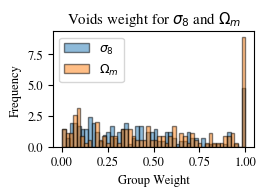

In [382]:
import matplotlib.pyplot as plt

# Your existing setup
plt.figure(figsize=(2.6, 1.5))

# Assuming sigma_weights_flat, sigma_dark_flat, omega_weights_flat, omega_dark_flat are defined
# and threshold_dark and n_bins are also defined

# Histogram for sigma_void
plt.hist([sigma_weights_flat[i] for i in range(len(sigma_dark_flat)) if sigma_dark_flat[i] > threshold_dark],
         label=r'$\sigma_8$', bins=n_bins, density=True, alpha=0.5, edgecolor='black')

# Histogram for omega_void
plt.hist([omega_weights_flat[i] for i in range(len(omega_dark_flat)) if omega_dark_flat[i] > threshold_dark],
         label=r'$\Omega_m$', bins=n_bins, density=True, alpha=0.5, edgecolor='black')

# Adding labels and title
plt.title('Voids weight for $\sigma_8$ and $\Omega_m$')
plt.xlabel('Group Weight')
plt.ylabel('Frequency')
plt.legend()

# Saving the figure
plt.savefig('../neurips2024_figs/cosmogrid_voids.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

# Show the plot
plt.show()


In [174]:
np.mean([sigma_weights_flat[i] for i in range(len(sigma_dark_flat)) if sigma_dark_flat[i] > threshold_dark]), np.mean([omega_weights_flat[i] for i in range(len(omega_dark_flat)) if omega_dark_flat[i] > threshold_dark])

(0.18499622818954448, 0.23831518116045972)

In [102]:
with open('../neurips2024_figs/cosmogrid_sop_stats.json', 'wt') as output_file:
    json.dump(results_sop, output_file)

In [53]:
results_sop

{'omega_bright': {'count': 159,
  'mean': 0.016514196845486103,
  'std': 0.005464992275152489},
 'omega_dark': {'count': 132,
  'mean': 0.6225619279977047,
  'std': 0.03975849417697753},
 'sigma_bright': {'count': 195,
  'mean': 0.016578482239483258,
  'std': 0.0053453868476558315},
 'sigma_dark': {'count': 165,
  'mean': 0.6229129076004029,
  'std': 0.039728178671619485},
 'mean': 0.678125}

# Train

In [123]:
def eval(model, dataloader, criterion, sop=True, binary_threshold=-1, verbose=0, eval_all=False):
    print('Eval ...')
    model.eval()
    total_loss = 0.0
    correct = 0
    total = 0
    total_nnz = 0
    total_num_masks = 0
    total_coverage = 0
    total_nnz_all = 0
    correct_max = 0
    correct_max_omega = 0
    correct_max_sigma = 0
    correct_num = 0
    total_nnz_omega = 0
    total_nnz_sigma = 0
    total_num_masks_omega = 0
    total_num_masks_sigma = 0
    loss_all = []
    
    criterion_none = nn.MSELoss(reduction='none')

    with torch.no_grad():
        progress_bar_eval = tqdm(range(len(dataloader)))
        for bi, batch in enumerate(dataloader):
            if not eval_all:
                if bi % 10 != 0:
                    progress_bar_eval.update(1)
                    continue
            # Now you can use `inputs` and `labels` in your training loop.
            inputs, labels, masks, _ = batch
            inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
            masks = masks.to(device)
            bsz = inputs.shape[0]
            if seg == 'patch':
                masks = None

            if sop:
                outputs = model(inputs, masks, return_tuple=True, binary_threshold=binary_threshold)

                if verbose > 0:
                    if bi in [10, 20, 30]:
                        show_masks_weights(inputs, outputs)

                logits = outputs.logits

                for i in range(len(logits)):
                    for pred in range(2):

                        outputs_processed = get_masks_used(outputs, i=i, pred=pred)
                        masks = outputs_processed['masks_sort_used']
                        mask_weights = outputs_processed['mask_weights_sort_used']

                        # pred_mask_idxs_sort = outputs.mask_weights[i,:,pred].argsort(descending=True)
                        nnz = (masks[mask_weights != 0] > 0).sum() / masks[mask_weights != 0].view(-1).shape[0]
                        
                        if pred == 0:
                            total_nnz_omega += nnz.item()
                            total_num_masks_omega += len(masks)
                        else:
                            total_nnz_sigma += nnz.item()
                            total_num_masks_sigma += len(masks)
                        
                        coverage = masks.bool().sum(-3).bool().sum() / (masks.shape[-1] * masks.shape[-2])
                        total_coverage += coverage.item()
                    
                    nnz_all = (outputs.masks != 0).sum() / outputs.masks.view(-1).shape[0]
                    total_nnz_all += nnz_all.item()
                    
                # import pdb; pdb.set_trace()
                # preds_max = outputs.logits_all.argmax(-1) # (bsz, num_masks)
                # print('outputs.logits_all', outputs.logits_all.shape)
                # print('labels', labels.shape)
                loss_max = criterion_none(outputs.logits_all, 
                                     labels[:,None].expand(outputs.logits_all.shape)).min(1).values # check
                
                correct_max += loss_max.mean().item() * bsz #(preds_max == labels[:,None]).sum(-1).bool().sum().item()
                correct_max_omega += loss_max.sum(0)[0].item()
                correct_max_sigma += loss_max.sum(0)[1].item()
                correct_num += (loss_max < 0.01).sum().item()  #(preds_max == labels[:,None]).sum(-1).sum().item()
            else:
                outputs = model(inputs)
                logits = outputs.logits
                
                loss_max = criterion_none(outputs.logits, labels) # check
                
                # correct_max += loss_max.sum().item() #(preds_max == labels[:,None]).sum(-1).bool().sum().item()
                correct_max_omega += loss_max.sum(0)[0].item()
                correct_max_sigma += loss_max.sum(0)[1].item()
            
            # val loss
            loss = criterion(logits, labels) * bsz
            # import pdb; pdb.set_trace()
            loss_all.extend(criterion_none(logits, labels).mean(-1).cpu().numpy().tolist())
            total_loss += loss.item()
            
            # acc
            # _, predicted = torch.max(logits.data, 1)
            # correct += (predicted == labels).sum().item()
            # print('predicted', predicted, 'labels', labels)
            
            total += labels.size(0)
            
            progress_bar_eval.update(1)
            # if bi > 100:
            #     break
    
    val_acc = correct / total
    val_loss = total_loss / total
    val_nnz = total_nnz / total
    val_nnz_all = total_nnz_all / total
    val_n_masks_avg = total_num_masks / total
    val_coverage = total_coverage / total
    val_min_loss = correct_max / total
    val_min_loss_omega = correct_max_omega / total
    val_min_loss_sigma = correct_max_sigma / total
    val_perc_correct = correct_num / total
    val_n_masks_avg_omega = total_num_masks_omega / total
    val_n_masks_avg_sigma = total_num_masks_sigma / total
    
    model.train()
    
    return {
        'val_acc': val_acc,
        'val_loss': val_loss,
        'val_nnz': val_nnz,
        'val_nnz_all': val_nnz_all,
        'val_n_masks_avg': val_n_masks_avg,
        'val_coverage': val_coverage,
        'total': total,
        'val_min_loss': val_min_loss,
        'val_perc_correct': val_perc_correct,
        'val_n_masks_avg_omega': val_n_masks_avg_omega,
        'val_n_masks_avg_sigma': val_n_masks_avg_sigma,
        'val_min_loss_omega': val_min_loss_omega,
        'val_min_loss_sigma': val_min_loss_sigma,
        'loss_all': loss_all
    }

In [56]:
from torch.optim import SGD, AdamW

lr = 5e-6
# criterion = nn.CrossEntropyLoss()
# optimizer = optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr)

# lr = 0.00005
criterion = nn.MSELoss()
optimizer = optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr)


In [35]:
config.group_gen_scale = 0.1
target_nnz = 0.2

In [36]:
config.group_gen_scale = 0.06#config.group_gen_scale*(val_nnz_all / target_nnz) **2
model.config.group_gen_scale = config.group_gen_scale
model.group_gen_scale = config.group_gen_scale
model.input_attn.scale = config.group_gen_scale
model.input_attn.multihead_attns[0].scale = config.group_gen_scale

In [37]:
config.group_gen_scale, config.group_sel_scale

(0.06, 50)

In [38]:
config.group_gen_scale = 0.1#config.group_gen_scale*(val_nnz_all / target_nnz) **2
model.config.group_gen_scale = config.group_gen_scale
model.group_gen_scale = config.group_gen_scale
model.input_attn.scale = config.group_gen_scale
model.input_attn.multihead_attns[0].scale = config.group_gen_scale

config.group_sel_scale = 10
# set all the scales, maybe the better way to do this is to make the scale a variable to pass in instead of something that is set inside the model
model.config.group_sel_scale = config.group_sel_scale
model.group_sel_scale = config.group_sel_scale
model.output_attn.scale = config.group_sel_scale
model.output_attn.multihead_attn.scale = config.group_sel_scale

In [57]:
config.group_gen_scale, config.group_sel_scale

(0.06, 10)

In [124]:
test_results = eval(model, test_dataloader, criterion, sop=True)
print(test_results)

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

{'val_acc': 0.0, 'val_loss': 0.02523809698011194, 'val_nnz': 0.0, 'val_nnz_all': 0.1989650981766837, 'val_n_masks_avg': 0.0, 'val_coverage': 0.5427058689030153, 'total': 112, 'val_min_loss': 0.01765422523021698, 'val_perc_correct': 1.0267857142857142, 'val_n_masks_avg_omega': 2.142857142857143, 'val_n_masks_avg_sigma': 2.642857142857143, 'val_min_loss_omega': 0.026584186990346228, 'val_min_loss_sigma': 0.00872426200658083, 'loss_all': [0.012023965828120708, 0.023518120869994164, 0.008856862783432007, 0.010992195457220078, 0.00782304909080267, 0.04479818791151047, 0.003899158677086234, 0.030978713184595108, 0.06018953025341034, 0.011135084554553032, 0.03329348564147949, 0.017087237909436226, 0.03541288524866104, 0.023510774597525597, 0.017276769503951073, 0.015008918009698391, 0.011034928262233734, 0.017340704798698425, 0.013593098148703575, 0.03015865571796894, 0.0119555639103055, 0.00754743255674839, 0.04979338496923447, 0.011363220401108265, 0.025623701512813568, 0.040204938501119614

In [125]:
len(test_results['loss_all'])

112

In [119]:
test_results

{'val_acc': 0.0,
 'val_loss': 0.02523809698011194,
 'val_nnz': 0.0,
 'val_nnz_all': 0.1989650981766837,
 'val_n_masks_avg': 0.0,
 'val_coverage': 0.5427058689030153,
 'total': 112,
 'val_min_loss': 0.01765422523021698,
 'val_perc_correct': 1.0267857142857142,
 'val_n_masks_avg_omega': 2.142857142857143,
 'val_n_masks_avg_sigma': 2.642857142857143,
 'val_min_loss_omega': 0.026584186990346228,
 'val_min_loss_sigma': 0.00872426200658083}

In [126]:
with open('../neurips2024_figs/cosmogrid_sop_loss.json', 'wt') as output_file:
    json.dump({
        'loss': test_results['val_loss'],
        'loss_all': test_results['loss_all']
    }, output_file)

In [165]:
backbone_test_results = eval(wrapped_backbone_model, test_dataloader, criterion, sop=False)
print('Backbone', backbone_test_results)
# backbone_val_loss = backbone_val_results['val_loss']

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Backbone {'val_acc': 0.0, 'val_loss': 0.008689412448023046, 'val_nnz': 0.0, 'val_nnz_all': 0.0, 'val_n_masks_avg': 0.0, 'val_coverage': 0.0, 'total': 112, 'val_min_loss': 0.0, 'val_perc_correct': 0.0, 'val_n_masks_avg_omega': 0.0, 'val_n_masks_avg_sigma': 0.0, 'val_min_loss_omega': 0.00613105739466846, 'val_min_loss_sigma': 0.011247767401593072, 'loss_all': [0.0002871084143407643, 0.0011591942748054862, 0.031213510781526566, 0.0019967490807175636, 0.0013530398719012737, 0.02811872400343418, 0.007371583022177219, 0.002189604565501213, 0.04643295705318451, 0.02377360314130783, 0.010336127132177353, 0.0015018958365544677, 0.00019836591673083603, 0.006274180021136999, 0.012896896339952946, 0.006891913712024689, 0.011478940024971962, 0.0006173751899041235, 0.00015527615323662758, 0.0013080640928819776, 0.01804620772600174, 0.00089754827786237, 0.002756949048489332, 0.01722509041428566, 0.0065765418112277985, 0.014231795445084572, 0.009798484854400158, 0.0029108633752912283, 0.01832690089941

In [166]:
with open('../neurips2024_figs/cosmogrid_backbone_loss.json', 'wt') as output_file:
    json.dump({
        'loss': backbone_test_results['val_loss'],
        'loss_all': backbone_test_results['loss_all']
    }, output_file)

In [24]:
val_results = eval(model, val_dataloader, criterion, sop=True)
print(val_results)

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

{'val_acc': 0.0, 'val_loss': 0.04819955996104649, 'val_nnz': 0.0, 'val_nnz_all': 0.19907147969518388, 'val_n_masks_avg': 0.0, 'val_coverage': 0.9804169865591186, 'total': 112, 'val_min_loss': 0.015085866674780846, 'val_perc_correct': 1.2142857142857142, 'val_n_masks_avg_omega': 6.3125, 'val_n_masks_avg_sigma': 4.678571428571429, 'val_min_loss_omega': 0.020437379367649555, 'val_min_loss_sigma': 0.009734354114958219}


In [18]:
backbone_val_results = eval(wrapped_backbone_model, val_dataloader, criterion, sop=False)
print('Backbone', backbone_val_results)
backbone_val_loss = backbone_val_results['val_loss']

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

/opt/conda/envs/rapids/lib/python3.10/site-packages/torch/nn/modules/conv.py:459: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


Backbone {'val_acc': 0.0, 'val_loss': 0.007613466387348515, 'val_nnz': 0.0, 'val_nnz_all': 0.0, 'val_n_masks_avg': 0.0, 'val_coverage': 0.0, 'total': 112, 'val_min_loss': 0.0, 'val_perc_correct': 0.0, 'val_n_masks_avg_omega': 0.0, 'val_n_masks_avg_sigma': 0.0, 'val_min_loss_omega': 0.004824045679665038, 'val_min_loss_sigma': 0.01040288679567831}


In [20]:
train_val_results = eval(model, train_val_dataloader, criterion, sop=True)
print('train_val_results', train_val_results)

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

train_val_results {'val_acc': 0.0, 'val_loss': 0.03181504750890391, 'val_nnz': 0.0, 'val_nnz_all': 0.19895065043653762, 'val_n_masks_avg': 0.0, 'val_coverage': 0.6502771177994353, 'total': 112, 'val_min_loss': 0.015924917667039802, 'val_perc_correct': 1.2142857142857142, 'val_n_masks_avg_omega': 7.964285714285714, 'val_n_masks_avg_sigma': 3.8035714285714284, 'val_min_loss_omega': 0.01776217682553189, 'val_min_loss_sigma': 0.014087658708116837}


In [66]:
backbone_val_acc = backbone_val_results['val_acc']

In [ ]:

backbone_val_results = eval(wrapped_backbone_model, val_dataloader, criterion, sop=False)
backbone_val_acc = backbone_val_results['val_acc']
print('Backbone val acc: ', backbone_val_acc)

val_results = eval(model, val_dataloader, criterion, sop=True)
val_acc = val_results['val_acc']
val_nnz_all = val_results['val_nnz_all']
val_max_acc = val_results['val_max_acc']
val_perc_correct = val_results['val_perc_correct']
val_coverage = val_results['val_coverage']
print('Untrained sop val acc: ', val_acc, 'val_max_acc', val_max_acc, 'val_perc_correct', val_perc_correct, 'val_nnz_all', val_nnz_all)


train_val_results = eval(model, train_val_dataloader, criterion, sop=True)
train_val_acc = train_val_results['val_acc']
train_val_nnz_all = train_val_results['val_nnz_all']
train_val_max_acc = train_val_results['val_max_acc']
train_val_perc_correct = train_val_results['val_perc_correct']
train_val_coverage = train_val_results['val_coverage']
print('Untrained sop train_val acc: ', train_val_acc, 'train_val_max_acc', train_val_max_acc, 'train_val_perc_correct', train_val_perc_correct, 'train_val_nnz_all', train_val_nnz_all)


In [62]:
config.group_gen_scale, config.group_sel_scale

(0.00027, 0.01)

In [23]:
target_nnz = 0.2
# target_nm = 4

backbone_val_loss,▁
step,▁
backbone_val_loss,0.00761
step,0


  0%|          | 0/5000 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


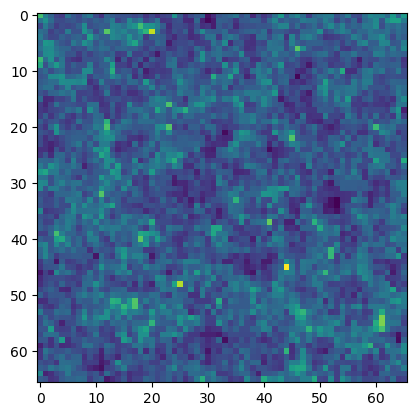

selected masks


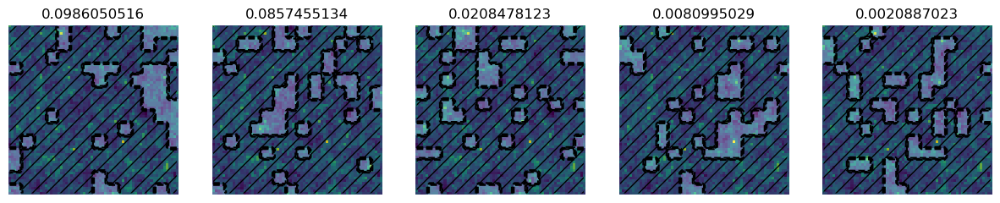

all masks


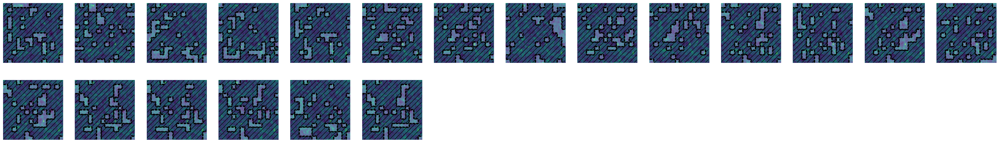

original


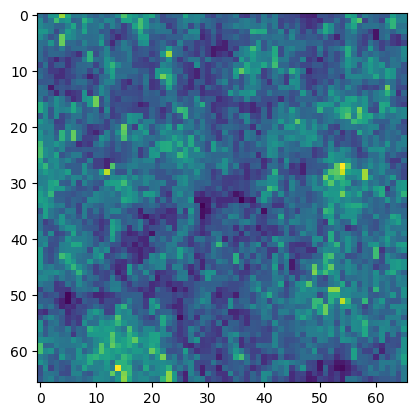

selected masks


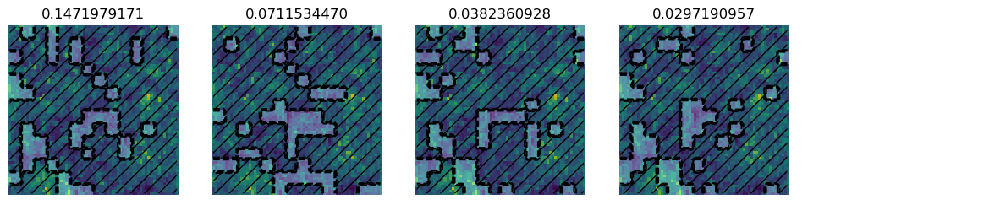

all masks


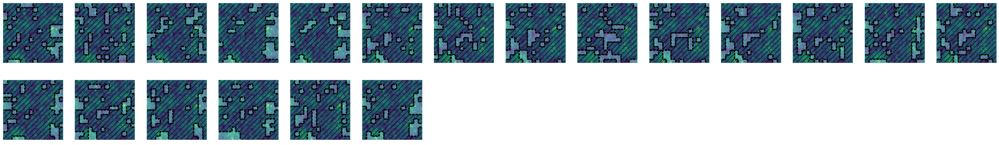

original


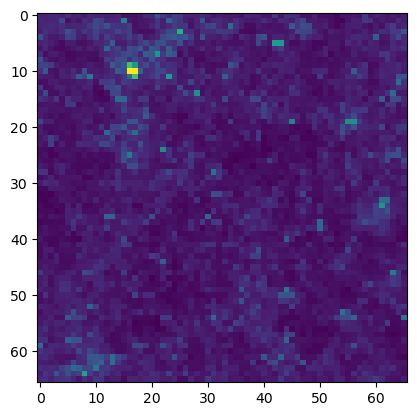

selected masks


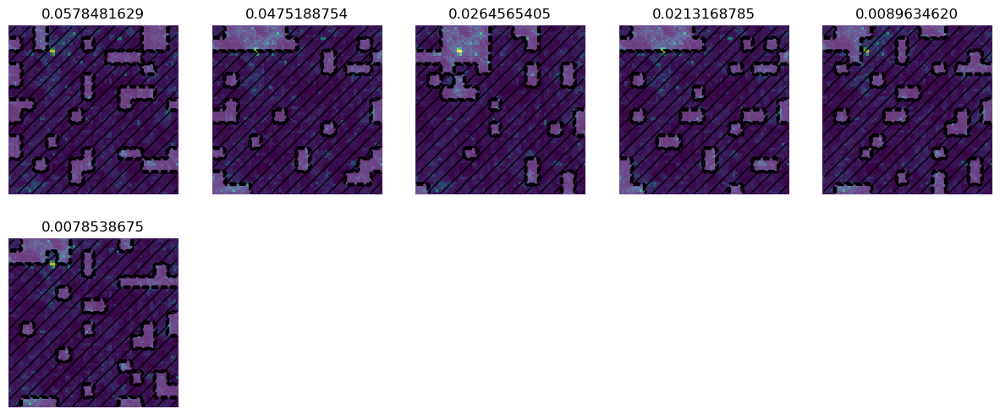

all masks


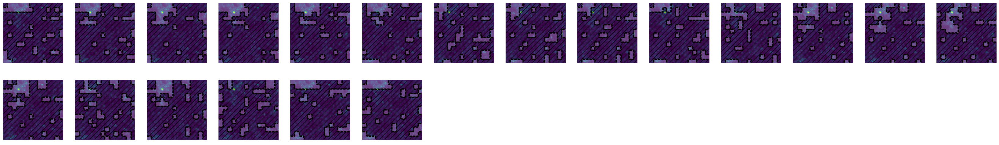

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


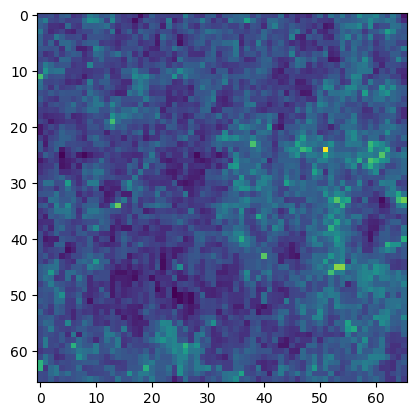

selected masks


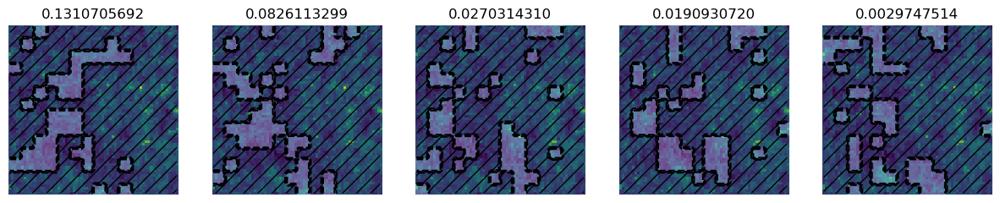

all masks


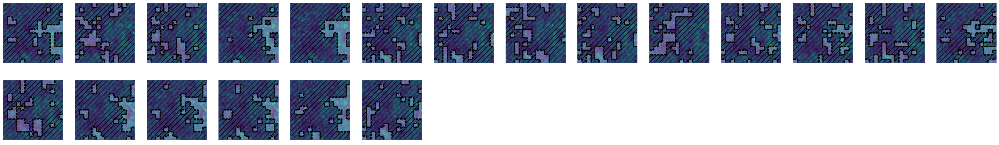

original


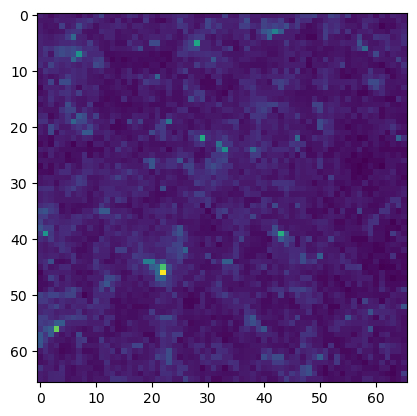

selected masks


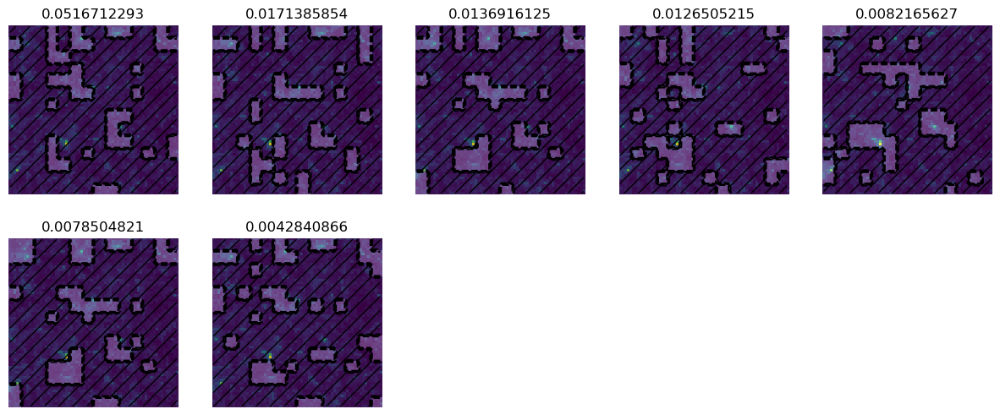

all masks


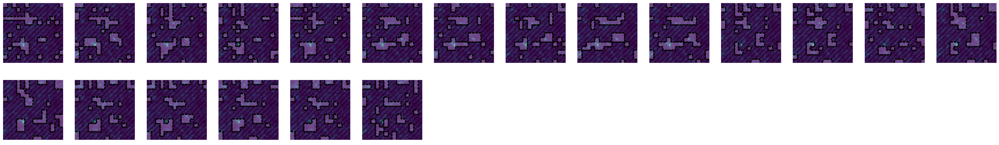

original


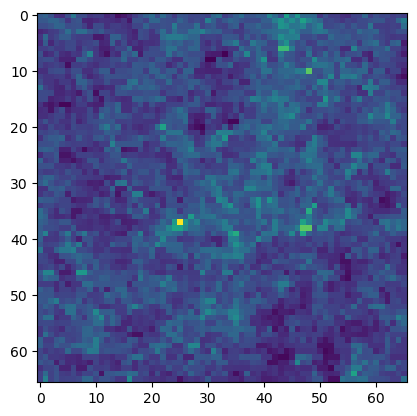

selected masks


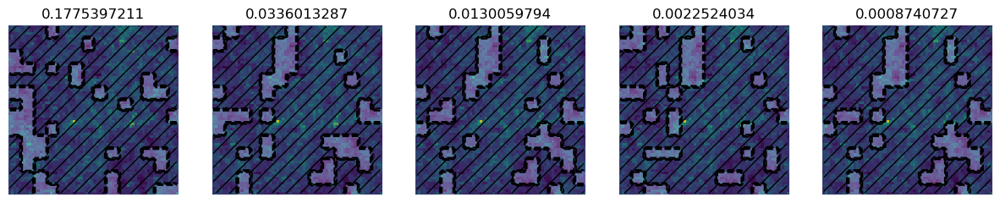

all masks


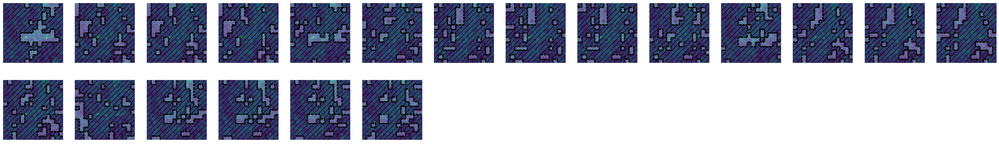

Epoch 0, Step 0, Val loss 0.0482
new best val loss: 0.048246950177209716
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 100, Loss 0.0519, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


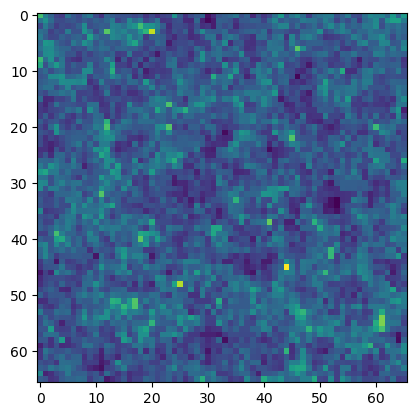

selected masks


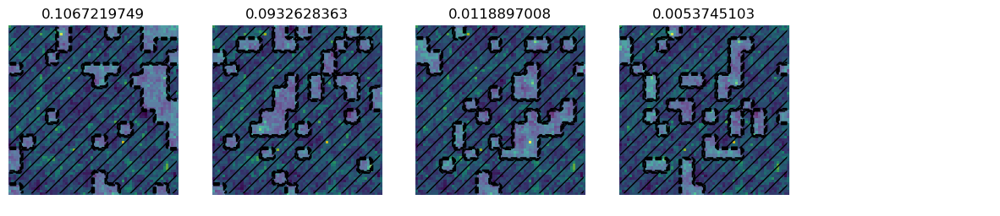

all masks


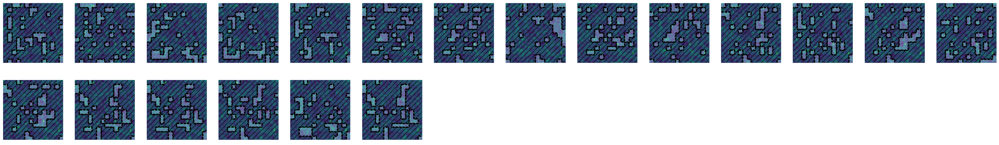

original


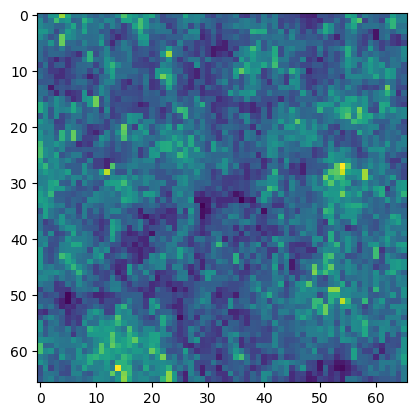

selected masks


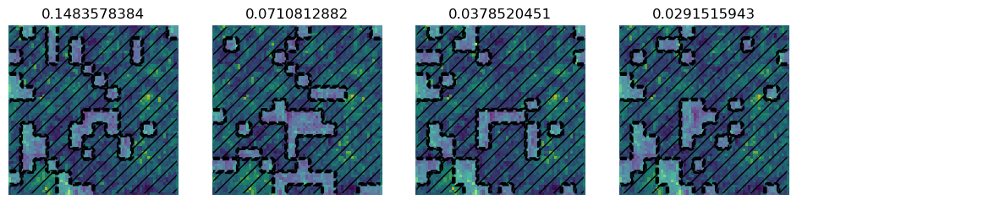

all masks


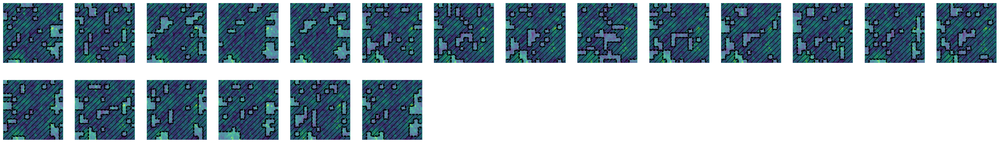

original


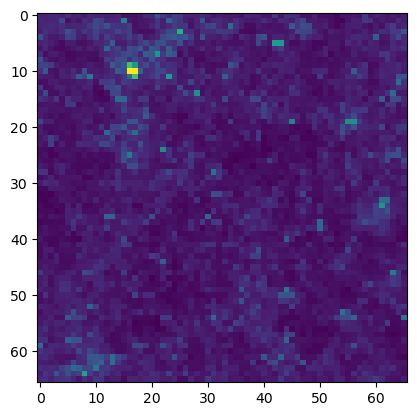

selected masks


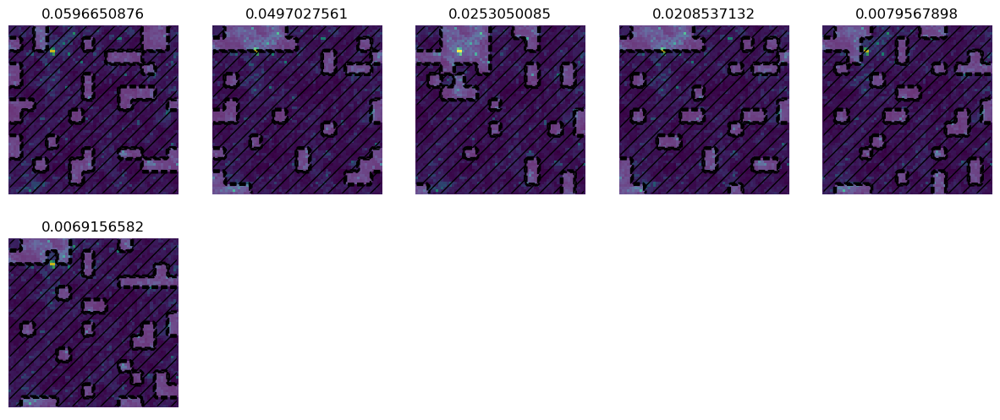

all masks


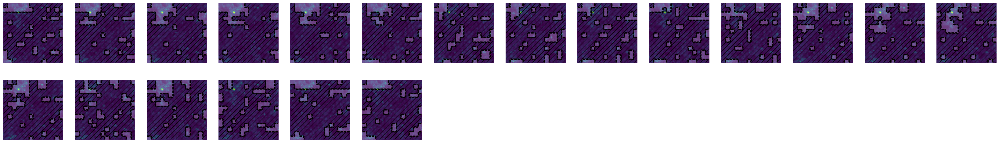

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


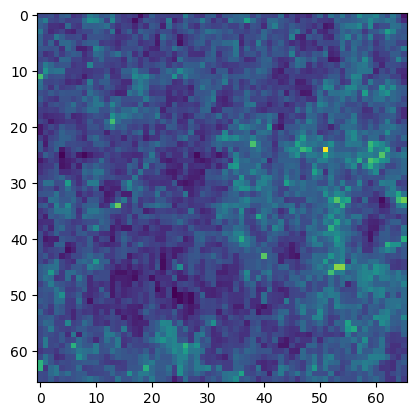

selected masks


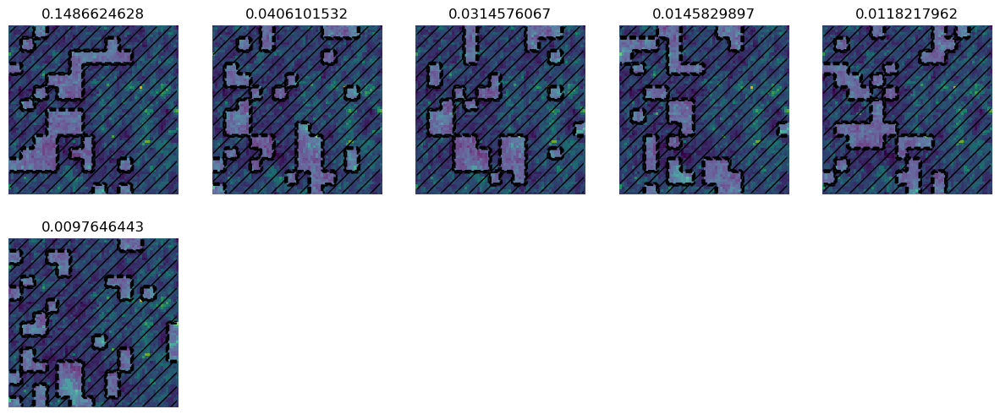

all masks


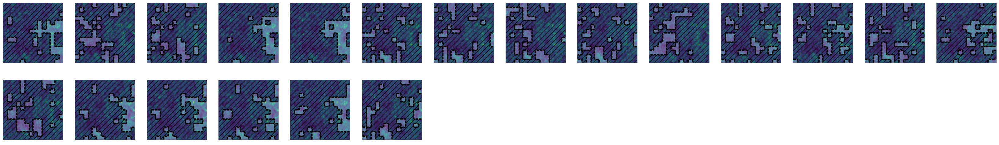

original


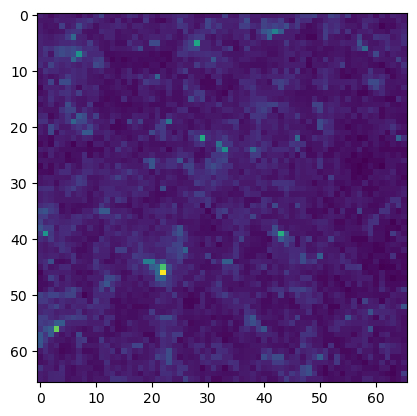

selected masks


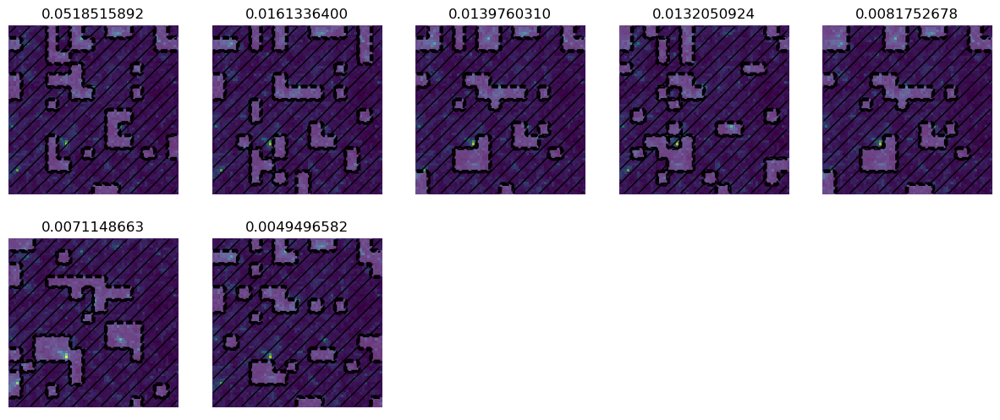

all masks


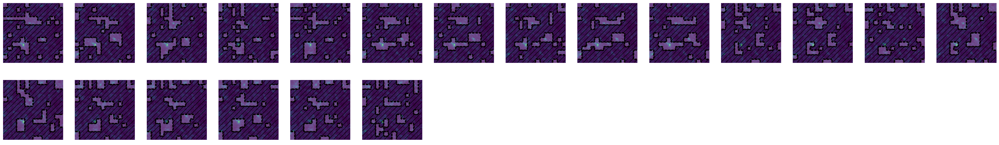

original


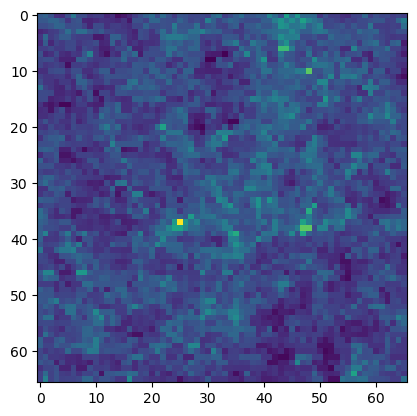

selected masks


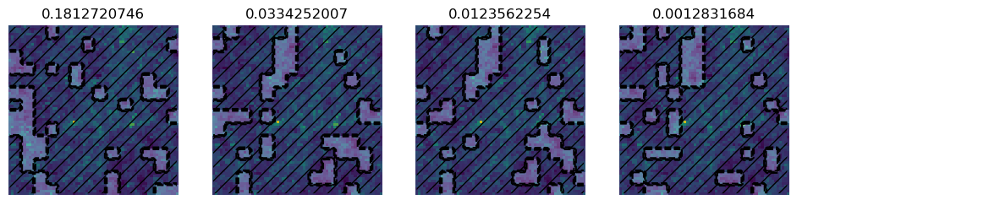

all masks


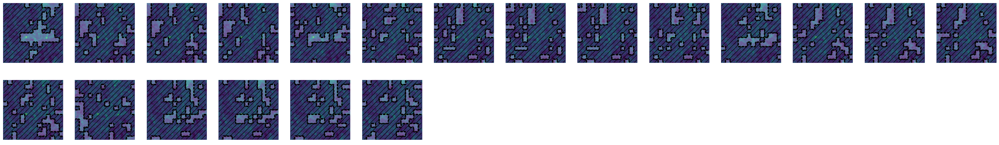

Epoch 0, Step 100, Val loss 0.0487
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 200, Loss 0.0537, LR 0.00000500
Epoch 0, Batch 300, Loss 0.0558, LR 0.00000500
Epoch 0, Batch 400, Loss 0.0571, LR 0.00000500
Epoch 0, Batch 500, Loss 0.0545, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 500, Val loss 0.0490
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 600, Loss 0.0545, LR 0.00000500
Epoch 0, Batch 700, Loss 0.0576, LR 0.00000500
Epoch 0, Batch 800, Loss 0.0561, LR 0.00000500
Epoch 0, Batch 900, Loss 0.0576, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 900, Val loss 0.0490
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 1000, Loss 0.0572, LR 0.00000500
Epoch 0, Batch 1100, Loss 0.0588, LR 0.00000500
Epoch 0, Batch 1200, Loss 0.0593, LR 0.00000500
Epoch 0, Batch 1300, Loss 0.0465, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 1300, Val loss 0.0491
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 1400, Loss 0.0398, LR 0.00000500
Epoch 0, Batch 1500, Loss 0.0402, LR 0.00000500
Epoch 0, Batch 1600, Loss 0.0387, LR 0.00000500
Epoch 0, Batch 1700, Loss 0.0383, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 1700, Val loss 0.0486
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 1800, Loss 0.0393, LR 0.00000500
Epoch 0, Batch 1900, Loss 0.0401, LR 0.00000500
Epoch 0, Batch 2000, Loss 0.0386, LR 0.00000500
Epoch 0, Batch 2100, Loss 0.0387, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 2100, Val loss 0.0477
new best val loss: 0.04770695152027266
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 2200, Loss 0.0389, LR 0.00000500
Epoch 0, Batch 2300, Loss 0.0399, LR 0.00000500
Epoch 0, Batch 2400, Loss 0.0405, LR 0.00000500
Epoch 0, Batch 2500, Loss 0.0378, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 2500, Val loss 0.0452
new best val loss: 0.04516708105802536
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 2600, Loss 0.0380, LR 0.00000500
Epoch 0, Batch 2700, Loss 0.0338, LR 0.00000500
Epoch 0, Batch 2800, Loss 0.0320, LR 0.00000500
Epoch 0, Batch 2900, Loss 0.0291, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 2900, Val loss 0.0330
new best val loss: 0.03302361709730966
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 3000, Loss 0.0294, LR 0.00000500
Epoch 0, Batch 3100, Loss 0.0283, LR 0.00000500
Epoch 0, Batch 3200, Loss 0.0276, LR 0.00000500
Epoch 0, Batch 3300, Loss 0.0283, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 3300, Val loss 0.0322
new best val loss: 0.03219559735485485
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 3400, Loss 0.0278, LR 0.00000500
Epoch 0, Batch 3500, Loss 0.0287, LR 0.00000500
Epoch 0, Batch 3600, Loss 0.0271, LR 0.00000500
Epoch 0, Batch 3700, Loss 0.0278, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 3700, Val loss 0.0325
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 3800, Loss 0.0323, LR 0.00000500
Epoch 0, Batch 3900, Loss 0.0371, LR 0.00000500
Epoch 0, Batch 4000, Loss 0.0380, LR 0.00000500
Epoch 0, Batch 4100, Loss 0.0392, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


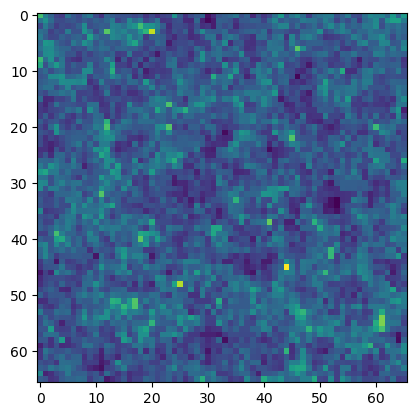

selected masks


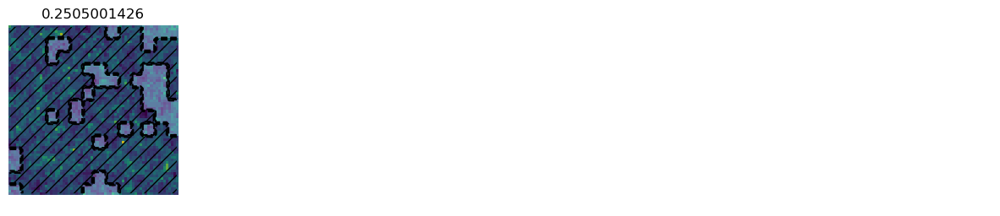

all masks


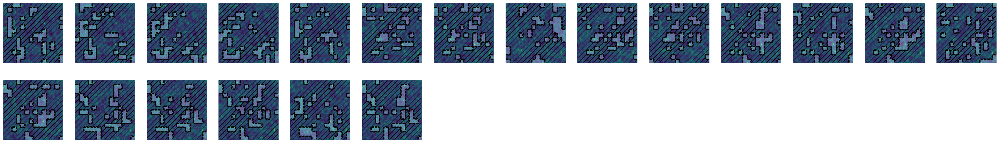

original


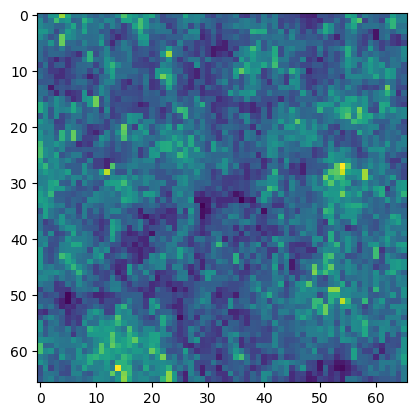

selected masks


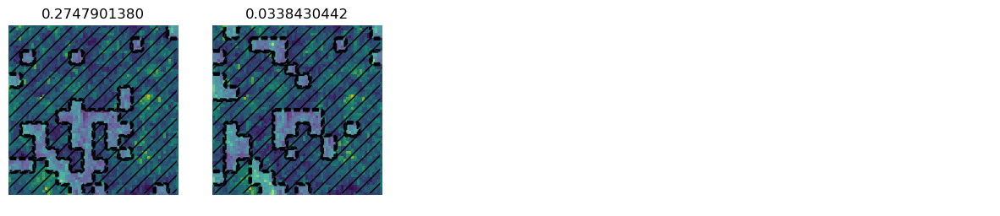

all masks


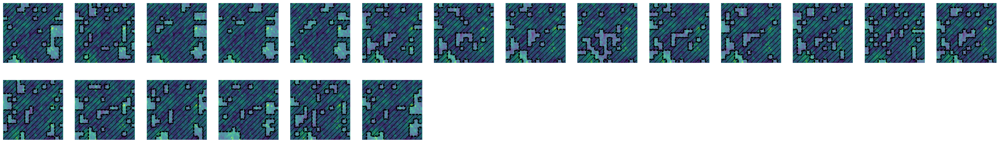

original


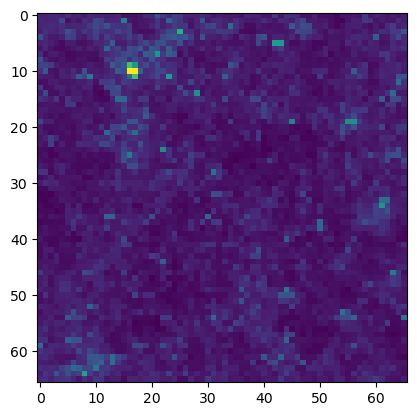

selected masks


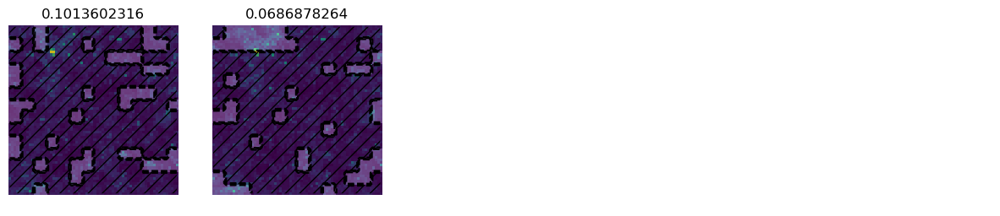

all masks


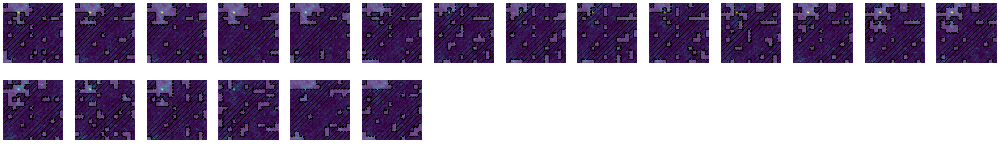

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


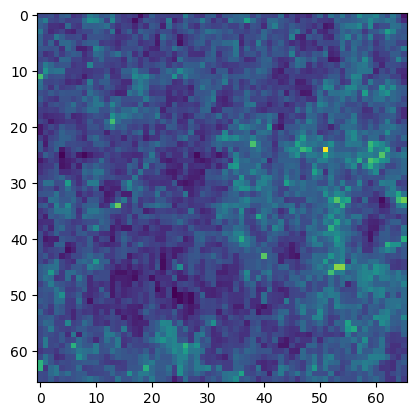

selected masks


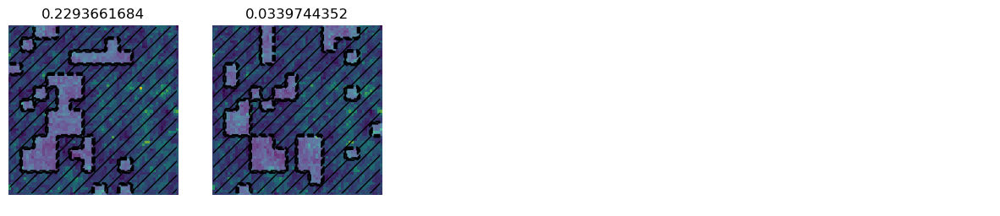

all masks


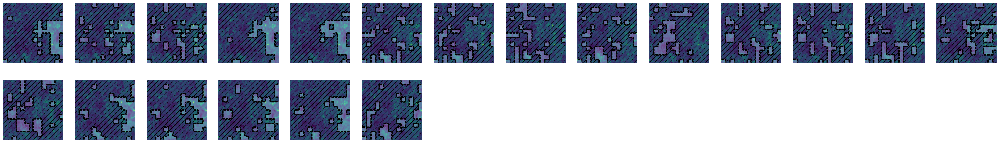

original


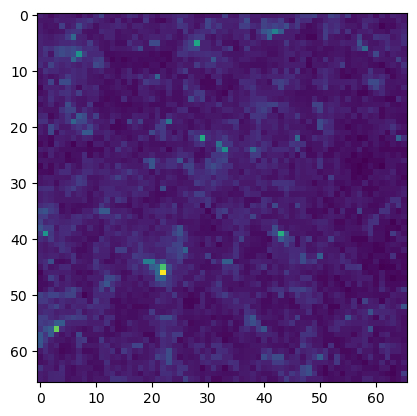

selected masks


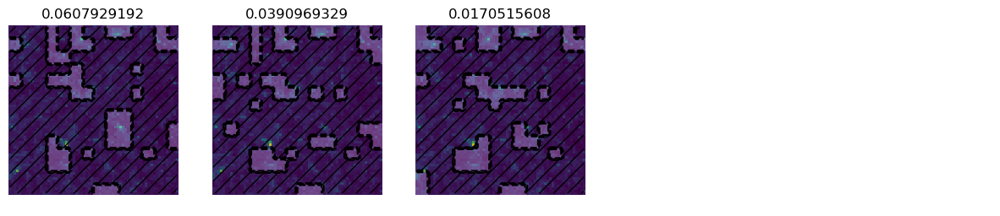

all masks


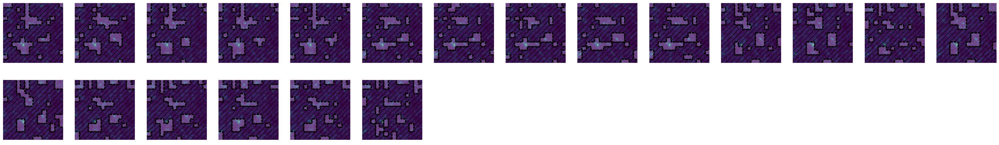

original


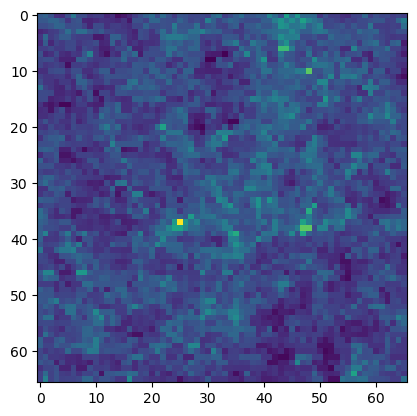

selected masks


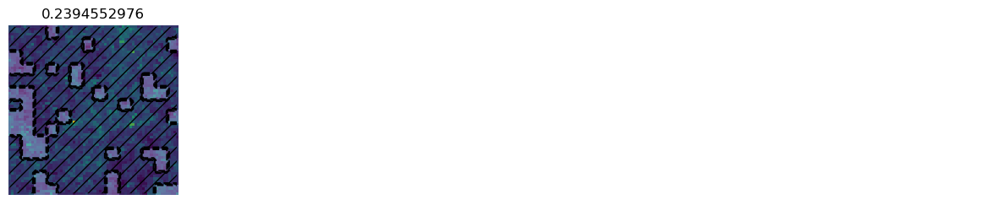

all masks


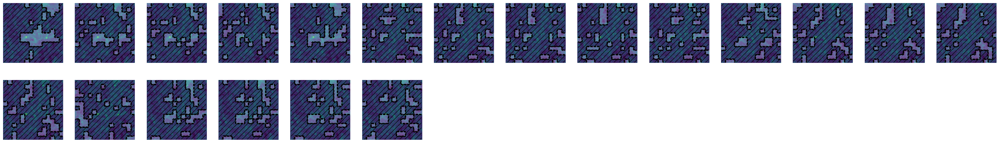

Epoch 0, Step 4100, Val loss 0.0319
new best val loss: 0.03186303483588355
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 4200, Loss 0.0387, LR 0.00000500
Epoch 0, Batch 4300, Loss 0.0365, LR 0.00000500
Epoch 0, Batch 4400, Loss 0.0366, LR 0.00000500
Epoch 0, Batch 4500, Loss 0.0390, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 4500, Val loss 0.0318
new best val loss: 0.031816357746720314
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 4600, Loss 0.0376, LR 0.00000500
Epoch 0, Batch 4700, Loss 0.0363, LR 0.00000500
Epoch 0, Batch 4800, Loss 0.0376, LR 0.00000500
Epoch 0, Batch 4900, Loss 0.0358, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 4900, Val loss 0.0316
new best val loss: 0.03161045749272619
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 0, Batch 5000, Loss 0.0366, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 0, Step 4999, Val loss 0.0314
new best val loss: 0.0314225647598505
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth


In [24]:
import logging

track = True
# track = False

exp_dir = f'../exps/cosmogrid_lr{lr}_tgtnnz{target_nnz}_gg{config.group_gen_scale:.4f}_gs{config.group_sel_scale:.4f}_ft_identify_fixk_scratch_ks{config.group_gen_blur_ks1}_seg{seg}_{num_heads}h'
os.makedirs(exp_dir, exist_ok=True)

# checkpoint dirs
last_dir = os.path.join(exp_dir, 'last')
best_dir = os.path.join(exp_dir, 'best')
best_checkpoint_path = os.path.join(best_dir, 'checkpoint.pth')
last_checkpoint_path = os.path.join(last_dir, 'checkpoint.pth')
config_best_checkpoint_path = os.path.join(best_dir, 'config.json')
config_last_checkpoint_path = os.path.join(last_dir, 'config.json')
result_best_checkpoint_path = os.path.join(best_dir, 'result.json')
result_last_checkpoint_path = os.path.join(last_dir, 'result.json')


if track:
    import wandb
    wandb.init(project='sop')
    wandb.run.name = os.path.basename(exp_dir)
    wandb.log({'backbone_val_loss': backbone_val_loss,
              # 'val_acc': val_acc,
              # 'train_val_acc': train_val_acc,
              'step': 0})

# Iterate over the data
best_val_loss = math.inf
step = 0
train_log_interval = 100
val_eval_interval = 400

criterion_none = nn.MSELoss(reduction='none')

logging.basicConfig(filename=os.path.join(exp_dir, 'train.log'), level=logging.INFO)

num_epochs = 1
num_training_steps = len(train_dataloader) * num_epochs
train_rep_step_size = int(num_training_steps / config.num_heads)

progress_bar = tqdm(range(num_training_steps))
model.train()
for epoch in range(math.ceil(num_epochs)):
    running_loss = 0.0
    running_loss_scaled = 0.0
    running_total = 0
    for i, batch in enumerate(train_dataloader):
        inputs, labels, masks, _ = batch
        inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
        masks = masks.to(device)
        bsz = inputs.shape[0]
        if seg == 'patch':
            masks = None
            
        optimizer.zero_grad()
        train_rep_step = step // train_rep_step_size
        outputs = model(inputs, masks, epoch=train_rep_step, mask_batch_size=mask_batch_size, 
                       return_tuple=True)
        logits = outputs.logits
        # loss = criterion(logits, labels)
        loss_all = criterion_none(logits, labels)
        loss = loss_all.mean()
        # print(loss.shape)
        # print('outputs.loss_scale', outputs.loss_scale.shape)
        # print('outputs.mask_weights', outputs.mask_weights.shape)
        # import pdb; pdb.set_trace()
        
        loss_scaled = ((outputs.mask_weights * (outputs.logits - labels)[:,None] * (- outputs.loss_scale[:,:,None])).sum(1) ** 2).mean()
        # loss_scaled = loss_all.mean() - (outputs.loss_scale[:,:,None] * outputs.mask_weights).sum(1).mean() / 20
        loss_scaled.backward()
        optimizer.step()
        
        running_loss += loss.item() * labels.size(0)
        running_loss_scaled += loss_scaled.item() * labels.size(0)
        running_total += labels.size(0)
        
        if i % train_log_interval == train_log_interval - 1 or i == len(train_dataloader) - 1:
            # Print training loss every 100 batches
            curr_lr = float(optimizer.param_groups[0]['lr'])
            log_message = f'Epoch {epoch}, Batch {i + 1}, Loss {running_loss / running_total:.4f}, LR {curr_lr:.8f}'
            print(log_message)
            logging.info(log_message)
            if track:
                wandb.log({'train_loss': running_loss / running_total,
                           'train_loss_scaled': running_loss_scaled / running_total,
                        'lr': curr_lr,
                        'epoch': epoch,
                        'step': step})
            running_loss = 0.0
            running_total = 0
            
        # if i % val_eval_interval == val_eval_interval - 1 or i == len(train_dataloader) - 1:
        if step == 0 or i % val_eval_interval == min(100, val_eval_interval - 1) or i == len(train_dataloader) - 1:
            if (i // val_eval_interval) % 10 == 0:
                verbose = 1
            else:
                verbose = 0
            val_results = eval(model, val_dataloader, criterion, verbose=verbose)
            train_val_results = eval(model, train_val_dataloader, criterion, binary_threshold=0.5, verbose=verbose)
            # {'val_acc': 0.0, 'val_loss': 0.03201764875224659, 'val_nnz': 0.0, 
            #  'val_nnz_all': 0.1989928718124117, 'val_n_masks_avg': 0.0, 
            #  'val_coverage': 0.7050455796665379, 'total': 112, 
            #  'val_min_loss': 0.0010318758182360657, 'val_perc_correct': 1.2410714285714286, 
            #  'val_n_masks_avg_omega': 8.25, 'val_n_masks_avg_sigma': 3.8839285714285716, 
            #  'val_min_loss_omega': 0.01620863424614072, 'val_min_loss_sigma': 0.016811391272182976}
            # val_acc = val_results['val_acc']
            val_loss = val_results['val_loss']
            val_nnz = val_results['val_nnz']
            val_nnz_all = val_results['val_nnz_all']
            val_n_masks_avg_omega = val_results['val_n_masks_avg_omega']
            val_n_masks_avg_sigma = val_results['val_n_masks_avg_sigma']
            # val_max_acc = val_results['val_max_acc']
            val_perc_correct = val_results['val_perc_correct']
            val_coverage = val_results['val_coverage']
            val_min_loss_omega = val_results['val_min_loss_omega']
            val_min_loss_sigma = val_results['val_min_loss_sigma']
            val_min_loss = val_results['val_min_loss']
            # train_val_acc = train_val_results['val_acc']
            train_val_loss = train_val_results['val_loss']
            train_val_nnz = train_val_results['val_nnz']
            train_val_nnz_all = train_val_results['val_nnz_all']
            train_val_n_masks_avg_omega = train_val_results['val_n_masks_avg_omega']
            train_val_n_masks_avg_sigma = train_val_results['val_n_masks_avg_sigma']
            # train_val_max_acc = train_val_results['val_max_acc']
            train_val_perc_correct = train_val_results['val_perc_correct']
            train_val_coverage = train_val_results['val_coverage']
            train_val_min_loss_omega = train_val_results['val_min_loss_omega']
            train_val_min_loss_sigma = train_val_results['val_min_loss_sigma']
            train_val_min_loss = train_val_results['val_min_loss']
            # config.group_gen_scale = config.group_gen_scale*(val_nnz_all / target_nnz) **2
            # model.config.group_gen_scale = config.group_gen_scale
            # model.group_gen_scale = config.group_gen_scale
            # model.input_attn.scale = config.group_gen_scale
            # model.input_attn.multihead_attns[0].scale = config.group_gen_scale
            # if val_n_masks_avg > target_nm:
            #     config.group_sel_scale *= 1.1
            #     # set all the scales, maybe the better way to do this is to make the scale a variable to pass in instead of something that is set inside the model
            #     model.config.group_sel_scale = config.group_sel_scale
            #     model.group_sel_scale = config.group_sel_scale
            #     model.output_attn.scale = config.group_sel_scale
            #     model.output_attn.multihead_attn.scale = config.group_sel_scale
            # elif val_n_masks_avg < target_nm:
            #     config.group_sel_scale /= 1.1
            #     # set all the scales, maybe the better way to do this is to make the scale a variable to pass in instead of something that is set inside the model
            #     model.config.group_sel_scale = config.group_sel_scale
            #     model.group_sel_scale = config.group_sel_scale
            #     model.output_attn.scale = config.group_sel_scale
            #     model.output_attn.multihead_attn.scale = config.group_sel_scale
            log_message = f'Epoch {epoch}, Step {step}, Val loss {val_loss:.4f}'
            print(log_message)
            logging.info(log_message)
            result = {
                # 'val_acc': val_acc,
                           'val_loss': val_loss,
                            'val_nnz': val_nnz,
                            'val_nnz_all': val_nnz_all,
                            'val_n_masks_avg_omega': val_n_masks_avg_omega,
                            'val_n_masks_avg_omega': val_n_masks_avg_omega,
                           # 'val_max_acc': val_max_acc,
                           'val_perc_correct': val_perc_correct,
                           'val_coverage': val_coverage,
                            'val_min_loss_omega': val_min_loss_omega,
                            'val_min_loss_sigma': val_min_loss_sigma,
                            'val_min_loss': val_min_loss,
                           # 'train_val_acc': train_val_acc,
                           'train_val_loss': train_val_loss,
                            'train_val_nnz': train_val_nnz,
                            'train_val_nnz_all': train_val_nnz_all,
                            'train_val_n_masks_avg_omega': train_val_n_masks_avg_omega,
                            'train_val_n_masks_avg_omega': train_val_n_masks_avg_omega,
                           # 'train_val_max_acc': train_val_max_acc,
                           'train_val_perc_correct': train_val_perc_correct,
                           'train_val_coverage': train_val_coverage,
                            'train_val_min_loss_omega': train_val_min_loss_omega,
                            'train_val_min_loss_sigma': train_val_min_loss_sigma,
                            'train_val_min_loss': train_val_min_loss,
                            'group_gen_scale': model.group_gen_scale,
                            'group_sel_scale': model.group_sel_scale,
                            'epoch': epoch,
                            'step': step
            }
            if track:
                wandb.log(result)
            
            
            checkpoint = {
                    'model': model.state_dict(),
                    'optimizer': optimizer.state_dict(),
                    # 'lr_scheduler': lr_scheduler.state_dict(),
                    'epoch': epoch,
                    'step': step,
                    'val_loss': val_loss,
                    # 'val_acc': val_acc,
                }
            if val_loss < best_val_loss:
                best_val_loss = val_loss
                print('new best val loss:', best_val_loss)
                os.makedirs(best_dir, exist_ok=True)
                torch.save(checkpoint, best_checkpoint_path)
                config.save_to_json(config_best_checkpoint_path)
                with open(result_best_checkpoint_path, 'wt') as output_file:
                    json.dump(result, output_file)
                print(f'Best checkpoint saved at {best_checkpoint_path}')
                
            os.makedirs(last_dir, exist_ok=True)
            torch.save(checkpoint, last_checkpoint_path)
            config.save_to_json(config_last_checkpoint_path)
            with open(result_last_checkpoint_path, 'wt') as output_file:
                    json.dump(result, output_file)
            print(f'Last checkpoint saved at {last_checkpoint_path}')
            
        # lr_scheduler.step()
        progress_bar.update(1)
        
        step += 1
        if step > num_training_steps:
            break
    if step > num_training_steps:
        break    

  0%|          | 0/20000 [00:00<?, ?it/s]

Epoch 1, Batch 100, Loss 0.0451, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


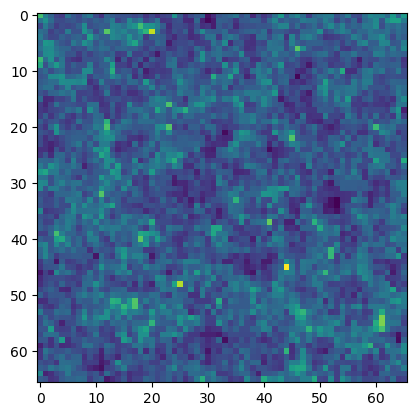

selected masks


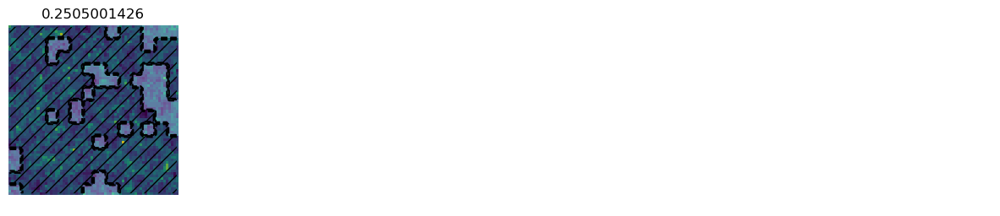

all masks


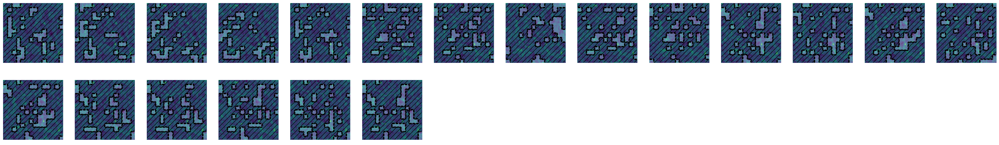

original


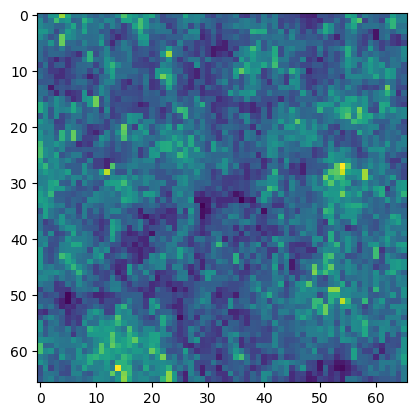

selected masks


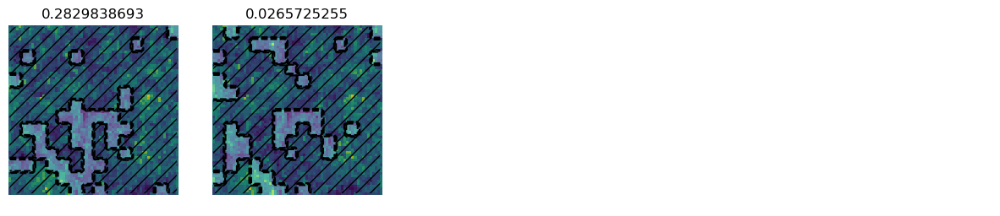

all masks


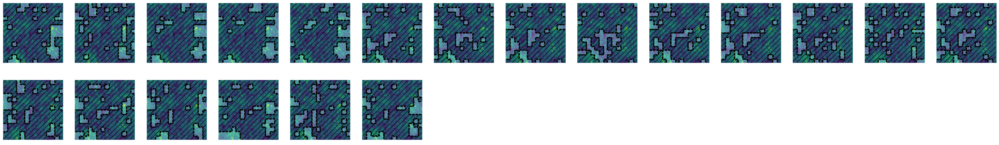

original


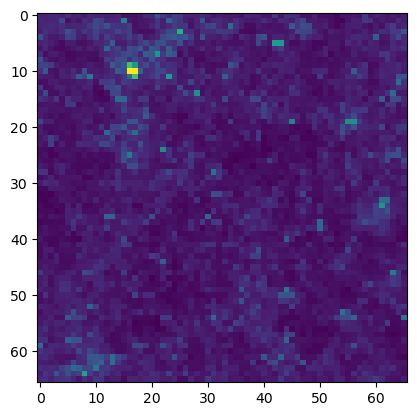

selected masks


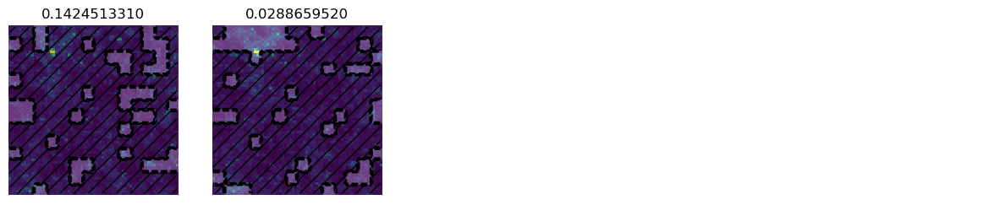

all masks


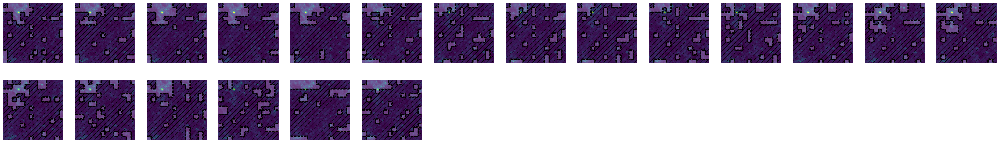

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

original


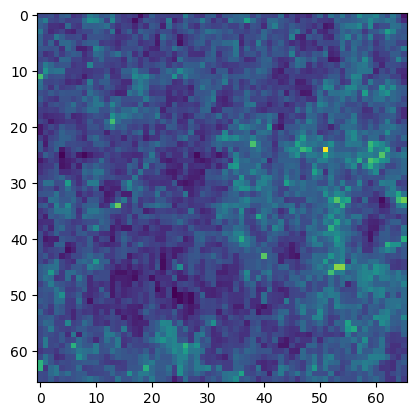

selected masks


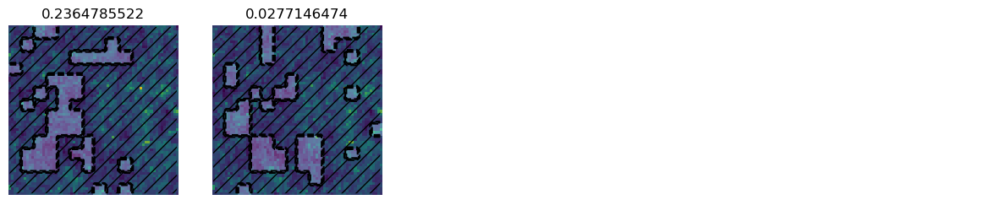

all masks


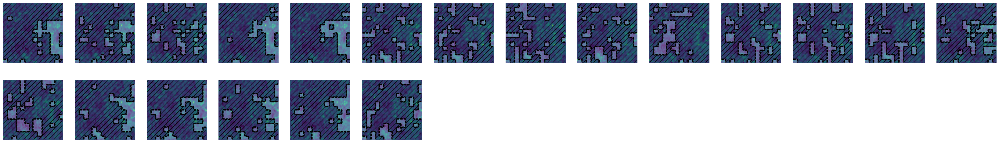

original


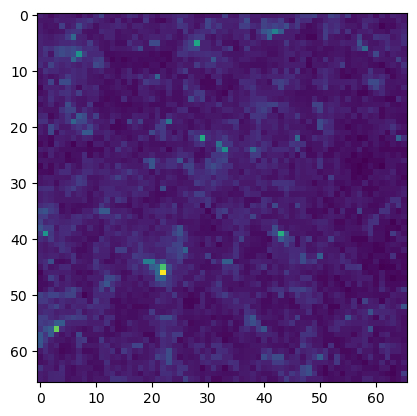

selected masks


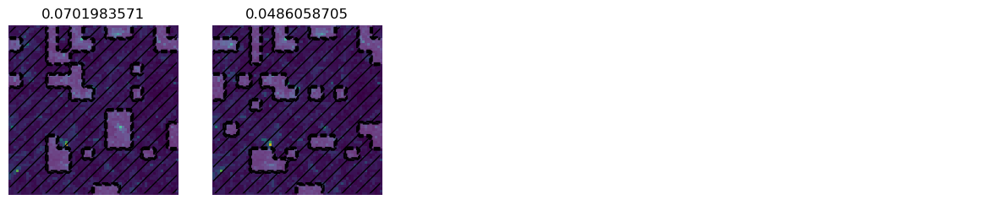

all masks


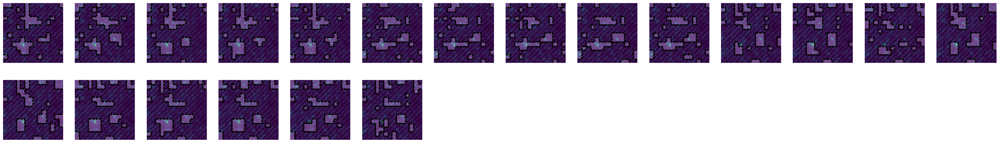

original


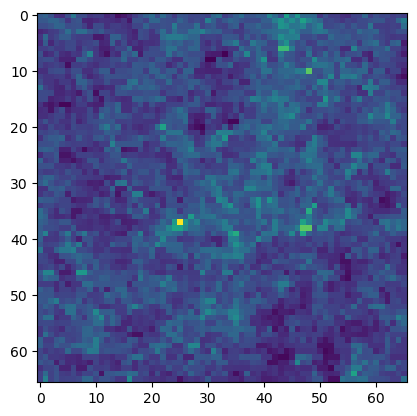

selected masks


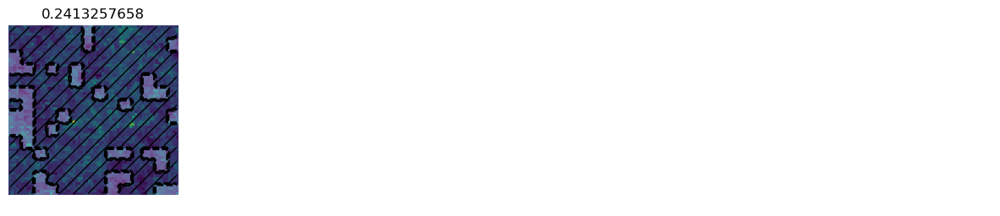

all masks


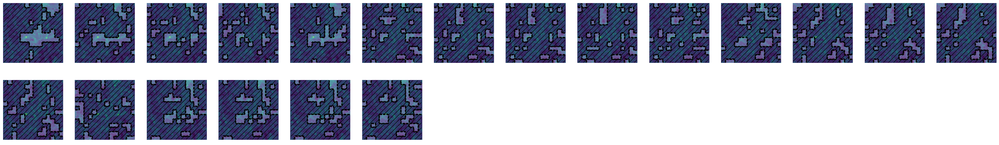

Epoch 1, Step 5101, Val loss 0.0318
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 200, Loss 0.0454, LR 0.00000500
Epoch 1, Batch 300, Loss 0.0463, LR 0.00000500
Epoch 1, Batch 400, Loss 0.0459, LR 0.00000500
Epoch 1, Batch 500, Loss 0.0466, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 1, Step 5501, Val loss 0.0327
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 600, Loss 0.0470, LR 0.00000500
Epoch 1, Batch 700, Loss 0.0454, LR 0.00000500
Epoch 1, Batch 800, Loss 0.0486, LR 0.00000500
Epoch 1, Batch 900, Loss 0.0482, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 1, Step 5901, Val loss 0.0331
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 1100, Loss 0.0474, LR 0.00000500
Epoch 1, Batch 1200, Loss 0.0478, LR 0.00000500
Epoch 1, Batch 1300, Loss 0.0379, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 1, Step 6301, Val loss 0.0332
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 1400, Loss 0.0257, LR 0.00000500
Epoch 1, Batch 1500, Loss 0.0259, LR 0.00000500
Epoch 1, Batch 1600, Loss 0.0253, LR 0.00000500
Epoch 1, Batch 1700, Loss 0.0259, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 1, Step 6701, Val loss 0.0331
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 1800, Loss 0.0264, LR 0.00000500
Epoch 1, Batch 1900, Loss 0.0270, LR 0.00000500
Epoch 1, Batch 2000, Loss 0.0259, LR 0.00000500
Epoch 1, Batch 2800, Loss 0.0284, LR 0.00000500
Epoch 1, Batch 2900, Loss 0.0263, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 1, Step 7901, Val loss 0.0321
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 3000, Loss 0.0276, LR 0.00000500
Epoch 1, Batch 3100, Loss 0.0281, LR 0.00000500
Epoch 1, Batch 3200, Loss 0.0283, LR 0.00000500
Epoch 1, Batch 3300, Loss 0.0282, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 1, Step 8301, Val loss 0.0320
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 1, Batch 3400, Loss 0.0283, LR 0.00000500
Epoch 1, Batch 3500, Loss 0.0280, LR 0.00000500
Epoch 1, Batch 3600, Loss 0.0262, LR 0.00000500
Epoch 1, Batch 3700, Loss 0.0279, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 2, Step 12501, Val loss 0.0303
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 2, Batch 2600, Loss 0.0270, LR 0.00000500
Epoch 2, Batch 2700, Loss 0.0270, LR 0.00000500
Epoch 2, Batch 2800, Loss 0.0268, LR 0.00000500
Epoch 2, Batch 2900, Loss 0.0280, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 2, Step 12901, Val loss 0.0304
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 2, Batch 3000, Loss 0.0264, LR 0.00000500
Epoch 2, Batch 3100, Loss 0.0266, LR 0.00000500
Epoch 2, Batch 3200, Loss 0.0278, LR 0.00000500
Epoch 2, Batch 3300, Loss 0.0265, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 2, Step 13301, Val loss 0.0302
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 2, Batch 3400, Loss 0.0286, LR 0.00000500
Epoch 2, Batch 3500, Loss 0.0272, LR 0.00000500


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 3, Batch 2000, Loss 0.0249, LR 0.00000500
Epoch 3, Batch 2100, Loss 0.0247, LR 0.00000500
Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Eval ...


  0%|          | 0/63 [00:00<?, ?it/s]

Epoch 3, Step 17101, Val loss 0.0285
new best val loss: 0.028485625184008052
Best checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/best/checkpoint.pth
Last checkpoint saved at ../exps/cosmogrid_lr5e-06_tgtnnz0.2_gg0.0600_gs10.0000_ft_identify_fixk_scratch_ks1_segpatch_4h/last/checkpoint.pth
Epoch 3, Batch 2200, Loss 0.0258, LR 0.00000500


KeyboardInterrupt: 

In [31]:
start_epoch = 1
num_epochs = 5

num_training_steps = len(train_dataloader) * (num_epochs - start_epoch)
# train_rep_step_size = int(num_training_steps / config.num_heads)

progress_bar = tqdm(range(num_training_steps))

for epoch in range(start_epoch, math.ceil(num_epochs)):
    running_loss = 0.0
    running_loss_scaled = 0.0
    running_total = 0
    for i, batch in enumerate(train_dataloader):
        inputs, labels, masks, _ = batch
        inputs, labels = inputs.to(device, dtype=torch.float), labels.to(device, dtype=torch.float)
        masks = masks.to(device)
        bsz = inputs.shape[0]
        if seg == 'patch':
            masks = None
            
        optimizer.zero_grad()
        train_rep_step = step // train_rep_step_size
        outputs = model(inputs, masks, epoch=train_rep_step, mask_batch_size=mask_batch_size, 
                       return_tuple=True)
        logits = outputs.logits
        # loss = criterion(logits, labels)
        loss_all = criterion_none(logits, labels)
        loss = loss_all.mean()
        # print(loss.shape)
        # print('outputs.loss_scale', outputs.loss_scale.shape)
        # print('outputs.mask_weights', outputs.mask_weights.shape)
        # import pdb; pdb.set_trace()
        
        loss_scaled = ((outputs.mask_weights * (outputs.logits - labels)[:,None] * (- outputs.loss_scale[:,:,None])).sum(1) ** 2).mean()
        # loss_scaled = loss_all.mean() - (outputs.loss_scale[:,:,None] * outputs.mask_weights).sum(1).mean() / 20
        loss_scaled.backward()
        optimizer.step()
        
        running_loss += loss.item() * labels.size(0)
        running_loss_scaled += loss_scaled.item() * labels.size(0)
        running_total += labels.size(0)
        
        if i % train_log_interval == train_log_interval - 1 or i == len(train_dataloader) - 1:
            # Print training loss every 100 batches
            curr_lr = float(optimizer.param_groups[0]['lr'])
            log_message = f'Epoch {epoch}, Batch {i + 1}, Loss {running_loss / running_total:.4f}, LR {curr_lr:.8f}'
            print(log_message)
            logging.info(log_message)
            if track:
                wandb.log({'train_loss': running_loss / running_total,
                           'train_loss_scaled': running_loss_scaled / running_total,
                        'lr': curr_lr,
                        'epoch': epoch,
                        'step': step})
            running_loss = 0.0
            running_total = 0
            
        # if i % val_eval_interval == val_eval_interval - 1 or i == len(train_dataloader) - 1:
        if step == 0 or i % val_eval_interval == min(100, val_eval_interval - 1) or i == len(train_dataloader) - 1:
            if (i // val_eval_interval) % 10 == 0:
                verbose = 1
            else:
                verbose = 0
            val_results = eval(model, val_dataloader, criterion, verbose=verbose)
            train_val_results = eval(model, train_val_dataloader, criterion, binary_threshold=0.5, verbose=verbose)
            # {'val_acc': 0.0, 'val_loss': 0.03201764875224659, 'val_nnz': 0.0, 
            #  'val_nnz_all': 0.1989928718124117, 'val_n_masks_avg': 0.0, 
            #  'val_coverage': 0.7050455796665379, 'total': 112, 
            #  'val_min_loss': 0.0010318758182360657, 'val_perc_correct': 1.2410714285714286, 
            #  'val_n_masks_avg_omega': 8.25, 'val_n_masks_avg_sigma': 3.8839285714285716, 
            #  'val_min_loss_omega': 0.01620863424614072, 'val_min_loss_sigma': 0.016811391272182976}
            # val_acc = val_results['val_acc']
            val_loss = val_results['val_loss']
            val_nnz = val_results['val_nnz']
            val_nnz_all = val_results['val_nnz_all']
            val_n_masks_avg_omega = val_results['val_n_masks_avg_omega']
            val_n_masks_avg_sigma = val_results['val_n_masks_avg_sigma']
            # val_max_acc = val_results['val_max_acc']
            val_perc_correct = val_results['val_perc_correct']
            val_coverage = val_results['val_coverage']
            val_min_loss_omega = val_results['val_min_loss_omega']
            val_min_loss_sigma = val_results['val_min_loss_sigma']
            val_min_loss = val_results['val_min_loss']
            # train_val_acc = train_val_results['val_acc']
            train_val_loss = train_val_results['val_loss']
            train_val_nnz = train_val_results['val_nnz']
            train_val_nnz_all = train_val_results['val_nnz_all']
            train_val_n_masks_avg_omega = train_val_results['val_n_masks_avg_omega']
            train_val_n_masks_avg_sigma = train_val_results['val_n_masks_avg_sigma']
            # train_val_max_acc = train_val_results['val_max_acc']
            train_val_perc_correct = train_val_results['val_perc_correct']
            train_val_coverage = train_val_results['val_coverage']
            train_val_min_loss_omega = train_val_results['val_min_loss_omega']
            train_val_min_loss_sigma = train_val_results['val_min_loss_sigma']
            train_val_min_loss = train_val_results['val_min_loss']
            # config.group_gen_scale = config.group_gen_scale*(val_nnz_all / target_nnz) **2
            # model.config.group_gen_scale = config.group_gen_scale
            # model.group_gen_scale = config.group_gen_scale
            # model.input_attn.scale = config.group_gen_scale
            # model.input_attn.multihead_attns[0].scale = config.group_gen_scale
            # if val_n_masks_avg > target_nm:
            #     config.group_sel_scale *= 1.1
            #     # set all the scales, maybe the better way to do this is to make the scale a variable to pass in instead of something that is set inside the model
            #     model.config.group_sel_scale = config.group_sel_scale
            #     model.group_sel_scale = config.group_sel_scale
            #     model.output_attn.scale = config.group_sel_scale
            #     model.output_attn.multihead_attn.scale = config.group_sel_scale
            # elif val_n_masks_avg < target_nm:
            #     config.group_sel_scale /= 1.1
            #     # set all the scales, maybe the better way to do this is to make the scale a variable to pass in instead of something that is set inside the model
            #     model.config.group_sel_scale = config.group_sel_scale
            #     model.group_sel_scale = config.group_sel_scale
            #     model.output_attn.scale = config.group_sel_scale
            #     model.output_attn.multihead_attn.scale = config.group_sel_scale
            log_message = f'Epoch {epoch}, Step {step}, Val loss {val_loss:.4f}'
            print(log_message)
            logging.info(log_message)
            result = {
                # 'val_acc': val_acc,
                           'val_loss': val_loss,
                            'val_nnz': val_nnz,
                            'val_nnz_all': val_nnz_all,
                            'val_n_masks_avg_omega': val_n_masks_avg_omega,
                            'val_n_masks_avg_omega': val_n_masks_avg_omega,
                           # 'val_max_acc': val_max_acc,
                           'val_perc_correct': val_perc_correct,
                           'val_coverage': val_coverage,
                            'val_min_loss_omega': val_min_loss_omega,
                            'val_min_loss_sigma': val_min_loss_sigma,
                            'val_min_loss': val_min_loss,
                           # 'train_val_acc': train_val_acc,
                           'train_val_loss': train_val_loss,
                            'train_val_nnz': train_val_nnz,
                            'train_val_nnz_all': train_val_nnz_all,
                            'train_val_n_masks_avg_omega': train_val_n_masks_avg_omega,
                            'train_val_n_masks_avg_omega': train_val_n_masks_avg_omega,
                           # 'train_val_max_acc': train_val_max_acc,
                           'train_val_perc_correct': train_val_perc_correct,
                           'train_val_coverage': train_val_coverage,
                            'train_val_min_loss_omega': train_val_min_loss_omega,
                            'train_val_min_loss_sigma': train_val_min_loss_sigma,
                            'train_val_min_loss': train_val_min_loss,
                            'group_gen_scale': model.group_gen_scale,
                            'group_sel_scale': model.group_sel_scale,
                            'epoch': epoch,
                            'step': step
            }
            if track:
                wandb.log(result)
            
            
            checkpoint = {
                    'model': model.state_dict(),
                    'optimizer': optimizer.state_dict(),
                    # 'lr_scheduler': lr_scheduler.state_dict(),
                    'epoch': epoch,
                    'step': step,
                    'val_loss': val_loss,
                    # 'val_acc': val_acc,
                }
            if val_loss < best_val_loss:
                best_val_loss = val_loss
                print('new best val loss:', best_val_loss)
                os.makedirs(best_dir, exist_ok=True)
                torch.save(checkpoint, best_checkpoint_path)
                config.save_to_json(config_best_checkpoint_path)
                with open(result_best_checkpoint_path, 'wt') as output_file:
                    json.dump(result, output_file)
                print(f'Best checkpoint saved at {best_checkpoint_path}')
                
            os.makedirs(last_dir, exist_ok=True)
            torch.save(checkpoint, last_checkpoint_path)
            config.save_to_json(config_last_checkpoint_path)
            with open(result_last_checkpoint_path, 'wt') as output_file:
                    json.dump(result, output_file)
            print(f'Last checkpoint saved at {last_checkpoint_path}')
            
        # lr_scheduler.step()
        progress_bar.update(1)
        
        step += 1
        if step > num_training_steps:
            break
    if step > num_training_steps:
        break    